# "Customer Personality Analysis & Predictive Segmentation: A Real-World Application"

#### This Customer Personality Analysis (CPA) project is an illustration of my real-time work experience. It encapsulates the process and approach I have utilized in professional settings, making it an important asset in my portfolio. The primary objective is to leverage data analysis and machine learning techniques to understand and segment a company's diverse customer base. The ultimate goal is to support the development of targeted marketing strategies and enhance customer engagement.

#### In the professional project, the workflow is organized into four stages:

#### 1.Customer Sentiment Analysis
#### 2.Customer Segmentation
#### 3.Predictive Model Development for Future Segmentation
#### 4.Product Recommendations

#### This portfolio project will focus on the second(Customer Segmentation) and third stages(Predictive Model Development for Future Segmentation), demonstrating my proficiency in customer segmentation and developing predictive models for future data segmentation.

## Introduction of the Project

##### My Customer Personality Analysis (CPA) project represents a crucial aspect of modern data-driven decision-making within the business context. Drawing from real-life experiences, this project serves to address the complexities and diversity within a company's customer base. Through machine learning and data analysis techniques, we aim to categorize customers into distinct segments based on their unique behaviors and characteristics. The goal of this project is to facilitate targeted marketing strategies, enhancing customer engagement, and promoting effective product recommendations.

### Project Stages

#### The project will proceed in two major stages, mirroring real-life project execution:

##### **Customer Segmentation**: This stage involves the use of clustering algorithms to classify customers into different groups based on their distinct attributes and purchasing behaviors. The derived segments will serve as a foundation for tailored marketing strategies and decision-making processes.

##### **Model Development for Future Data**: Building on the customer segmentation, this stage focuses on developing a predictive model that can handle future data. This model will enable the company to anticipate changes in customer behavior and adapt their strategies accordingly.

### Business Requirements

##### 1.The core business requirement is to provide an analytical foundation that enables marketing and strategy teams to identify and target specific customer segments. Key business needs include:

##### 2.Enabling targeted marketing campaigns by identifying customer segments more likely to respond positively.
##### 3.Streamlining product development by understanding the unique needs and preferences of different customer segments.
##### 3.Enhancing customer engagement by delivering personalized experiences based on individual customer segments.

### Proposed Solution

#### My solution focuses on leveraging machine learning techniques to meet the defined business requirements:

##### **Data Analysis and Clustering**: Conduct extensive data preprocessing and exploratory analysis to identify key features. Use clustering algorithms to create distinct customer segments.
#### **Predictive Model Development**: Post-segmentation, develop a robust predictive model using machine learning algorithms to anticipate future customer behaviors and preferences.

##### **This solution aims to equip marketing teams with actionable insights that enhance customer satisfaction and drive business performance. By identifying customer segments and predicting future behaviors, companies can create more targeted and effective marketing strategies.**

## Approach

Our approach to this project follows a structured, step-by-step methodology grounded in data science best practices. Each stage is thoughtfully designed to build upon the previous, ensuring a cohesive and comprehensive solution.

**Uderstanding the Data**: The first step involves a thorough understanding of the dataset, its variables, and its structure. This step is crucial for shaping the subsequent stages of the project.

**Data Preprocessing**: After understanding the dataset, we clean and preprocess the data. This involves handling missing values, potential outliers, and categorical variables, ensuring the data is ready for analysis.

**Exploratory Data Analysis (EDA)**: This stage involves unearthing patterns, spotting anomalies, testing hypotheses, and checking assumptions through visual and quantitative methods. It provides an in-depth understanding of the variables and their interrelationships, which aids in feature selection.

**Feature Selection**: Based on the insights from EDA, relevant features are selected for building the machine learning model. Feature selection is critical to improve the model's performance by eliminating irrelevant or redundant information.

**Customer Segmentation**: The preprocessed data is then fed into a clustering algorithm to group customers into distinct segments based on their attributes and behavior. This segmentation enables targeted marketing and personalized customer engagement.

**Model Development**: Once we have our customer segments, we develop a predictive model using a suitable machine learning algorithm. This model is trained on the current data and then validated using a separate test set.

**Model Evaluation and Optimization**: The model's performance is evaluated using appropriate metrics. If necessary, the model is fine-tuned and optimized to ensure the best possible performance.

**Prediction on Future Data**: The final step involves utilizing the trained model to make predictions on future data. This will allow the business to anticipate changes in customer behavior and adapt their strategies accordingly.

This approach ensures a systematic and thorough analysis of the customer data, leading to robust and reliable customer segments and predictions. It aims to provide a foundation upon which strategic business decisions can be made and future customer trends can be anticipated.

![Project Work FLow-Chart](model_folowchart.png)

In [1]:
import pandas as pd
import requests
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from scipy import stats
import ydata_profiling as pp
from datetime import datetime


import warnings
warnings.filterwarnings('ignore')

# Data Preprocessing 

### 1.Data Collection 

##### The data collection process in my  project involved using the "requests" library to retrieve a CSV file from a specific URL. The content was decoded using UTF-8 encoding, replacing semicolons with commas. The decoded content was saved to a local file. This process ensured the successful acquisition of the necessary data for further analysis and modeling.

In [2]:


url = "https://raw.githubusercontent.com/amankharwal/Website-data/master/marketing_campaign.csv"
filename = "marketing_campaign.csv"

response = requests.get(url)
response.raise_for_status()  # Check for any errors

with open(filename, "wb") as file:
    file.write(response.content)

print("CSV file downloaded successfully!")

CSV file downloaded successfully!


In [3]:


df = pd.read_csv('marketing_campaign.csv')

df.head()

,ID;Year_Birth;Education;Marital_Status;Income;Kidhome;Teenhome;Dt_Customer;Recency;MntWines;MntFruits;MntMeatProducts;MntFishProducts;MntSweetProducts;MntGoldProds;NumDealsPurchases;NumWebPurchases;NumCatalogPurchases;NumStorePurchases;NumWebVisitsMonth;AcceptedCmp3;AcceptedCmp4;AcceptedCmp5;AcceptedCmp1;AcceptedCmp2;Complain;Z_CostContact;Z_Revenue;Response
0,5524;1957;Graduation;Single;58138;0;0;2012-09-...
1,2174;1954;Graduation;Single;46344;1;1;2014-03-...
2,4141;1965;Graduation;Together;71613;0;0;2013-0...
3,6182;1984;Graduation;Together;26646;1;0;2014-0...
4,5324;1981;PhD;Married;58293;1;0;2014-01-19;94;...


Data is not separated my (,) comma, it separated by ;(colin)

In [4]:
# updated code 
url = "https://raw.githubusercontent.com/amankharwal/Website-data/master/marketing_campaign.csv"
filename = "marketing_campaign_updated.csv"

response = requests.get(url)
response.raise_for_status()  # Check for any errors

# Decode the content using UTF-8 and replace semicolons with commas
content = response.content.decode("utf-8")

with open(filename, "wb") as file:
    file.write(response.content)

print("CSV file downloaded successfully!")

CSV file downloaded successfully!


In [5]:
#load the data 
df = pd.read_csv('marketing_campaign_updated.csv', sep=';')

df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


In [6]:
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


In [6]:
#download the data file in repo
df.to_csv('final_data.csv', index=False)

### 2.Data Understanding (Attributes)


Attributes:

1. ID: Customer's unique identifier.
2. Year_Birth: Customer's birth year.

3. Education: Customer's education level, ranging from basic education to a master's degree or higher.

4. Marital_Status: Customer's marital status, including categories such as single, married, divorced, or widowed.

5. Income: Customer's yearly household income, representing the total income of all members in the household.

6. Kidhome: Number of children in the customer's household.

7. Teenhome: Number of teenagers in the customer's household.

8. Dt_Customer: Date of customer's enrollment with the company, indicating when the customer became a registered member.

9. Recency: Number of days since the customer's last purchase, providing a measure of the customer's engagement and recent activity.

10. Complain: Indicates whether the customer has made a complaint in the last 2 years. (1 if the customer has complained, 0 otherwise)

Products:

11. MntWines: Amount spent on wine in the last 2 years, reflecting the customer's expenditure on wine products.

12. MntFruits: Amount spent on fruits in the last 2 years, representing the customer's expenditure on fruit products.

13. MntMeatProducts: Amount spent on meat in the last 2 years, indicating the customer's expenditure on meat products.

14. MntFishProducts: Amount spent on fish in the last 2 years, representing the customer's expenditure on fish products.

15. MntSweetProducts: Amount spent on sweets in the last 2 years, reflecting the customer's expenditure on sweet products.

16. MntGoldProds: Amount spent on gold products in the last 2 years, indicating the customer's expenditure on gold items.

Promotion:

17. NumDealsPurchases: Number of purchases made with a discount, indicating the customer's engagement with promotional deals.

18. AcceptedCmp1: Indicates whether the customer accepted the offer in the 1st campaign. (1 if the customer accepted, 0 otherwise)

19. AcceptedCmp2: Indicates whether the customer accepted the offer in the 2nd campaign. (1 if the customer accepted, 0 otherwise)

20. AcceptedCmp3: Indicates whether the customer accepted the offer in the 3rd campaign. (1 if the customer accepted, 0 otherwise)

21. AcceptedCmp4: Indicates whether the customer accepted the offer in the 4th campaign. (1 if the customer accepted, 0 otherwise)

22. AcceptedCmp5: Indicates whether the customer accepted the offer in the 5th campaign. (1 if the customer accepted, 0 otherwise)

23. Response: Indicates whether the customer accepted the offer in the last campaign. (1 if the customer accepted, 0 otherwise)

Place:

24. NumWebPurchases: Number of purchases made through the company's website, indicating the customer's online purchasing behavior.

25. NumCatalogPurchases: Number of purchases made using a catalogue, reflecting the customer's engagement with catalog-based purchases.

26. NumStorePurchases: Number of purchases made directly in stores, indicating the customer's offline purchasing behavior.

27. NumWebVisitsMonth: Number of visits to the company's website in the last month, representing the customer's online engagement and browsing activity.


Acknowledgement
The dataset for this project is provided by Dr. Omar Romero-Hernandez.

Source : https://raw.githubusercontent.com/amankharwal/Website-data/master/marketing_campaign.csv

In [7]:
# display max columns 

pd.set_option('display.max_columns', 50)

df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0


### 3.Data Inspection

##### A pandas profiling analysis was conducted on the dataset using the ProfileReport function from the pandas profiling library. The resulting profile report provided a comprehensive summary of the data's structure, statistics, and distributions. The report was saved as an HTML file for reference and further analysis. The profiling analysis facilitated data understanding by revealing patterns, identifying missing values, and offering insights for subsequent data preprocessing and analysis tasks.

In [8]:
# ydata profiling is best way to summary of whole data 


data_profile = pp.ProfileReport(df)

data_profile.to_file('data_profile.html')

data_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### 4.Data Cleaning

1. Dropped duplicate rows from the DataFrame.

2. Dropped rows with missing values (NaN) from the DataFrame.

3. Converted the "Dt_Customer" column to a datetime format.

4. Removed the columns "Z_CostContact" and "Z_Revenue" as they contained only a single unique value.

5. Identified and counted the number of outliers for each numeric column using the interquartile range (IQR) method.





In [9]:
# drop duplicate rows

df.drop_duplicates(inplace=True)

In [10]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

To address missing values in the "income" attribute, it is decided to drop the null values to avoid potential distortions in clustering analysis, as income is a crucial feature for grouping the data accurately.

In [11]:
df.dropna(inplace=True)

In [12]:
# types of data features 

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2216 non-null   int64  
 1   Year_Birth           2216 non-null   int64  
 2   Education            2216 non-null   object 
 3   Marital_Status       2216 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2216 non-null   int64  
 6   Teenhome             2216 non-null   int64  
 7   Dt_Customer          2216 non-null   object 
 8   Recency              2216 non-null   int64  
 9   MntWines             2216 non-null   int64  
 10  MntFruits            2216 non-null   int64  
 11  MntMeatProducts      2216 non-null   int64  
 12  MntFishProducts      2216 non-null   int64  
 13  MntSweetProducts     2216 non-null   int64  
 14  MntGoldProds         2216 non-null   int64  
 15  NumDealsPurchases    2216 non-null   i

In [13]:
# change  dt_Customer to datetime format 

df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'])

In [14]:
# check unique values in each feature 
df.nunique()

ID                     2216
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1974
Kidhome                   3
Teenhome                  3
Dt_Customer             662
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         554
MntFishProducts         182
MntSweetProducts        176
MntGoldProds            212
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Z_CostContact             1
Z_Revenue                 1
Response                  2
dtype: int64

After examining the unique values in each feature of the DataFrame df using the df.nunique() function, it was observed that the columns "Z_CostContact" and "Z_Revenue" contain only a single unique value. As these columns do not contribute to the analysis and model development, it is decided to drop them from the dataset.

In [15]:
# drop features
df.drop(columns=['Z_CostContact','Z_Revenue'], axis=1, inplace=True)

### Outliers 

Outliers can have a significant impact on clustering models. They can distort the overall distribution and lead to biased cluster assignments. Outliers tend to pull cluster centroids towards them, resulting in less accurate cluster representation and potentially affecting the cluster boundaries. It is important to handle outliers carefully by either removing them or using robust clustering algorithms that are less sensitive to outliers to ensure more accurate and reliable clustering results.

In [16]:
numeric_cols = ['Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
                'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
                'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth']

outlier_count = {}
for col in numeric_cols:
    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    outlier_count[col] = len(outliers)

print(outlier_count)

{'Income': 8, 'Kidhome': 0, 'Teenhome': 0, 'Recency': 0, 'MntWines': 35, 'MntFruits': 246, 'MntMeatProducts': 174, 'MntFishProducts': 222, 'MntSweetProducts': 246, 'MntGoldProds': 205, 'NumDealsPurchases': 84, 'NumWebPurchases': 3, 'NumCatalogPurchases': 23, 'NumStorePurchases': 0, 'NumWebVisitsMonth': 8}


The identification of outliers in the dataset prompts further analysis to understand their context and relationship to the data. These outliers may provide insights into unique patterns, market segments, or exceptional customer behavior. It is crucial to investigate their validity and consider their influence carefully during modeling by using robust clustering algorithms or outlier-resistant techniques.

### 5. Feature Engineering & Label Encoding 

Feature engineering is a critical step in the process of building a machine learning model, including clustering and analysis. It involves creating new features or modifying existing ones to improve model performance. Good features can capture important aspects of the data that might not be immediately apparent, and can help the model make better predictions or identify more meaningful clusters. In clustering, well-crafted features can help distinguish between different groups in the data more effectively, leading to more accurate and insightful segmentation of customers.

In [17]:
# creating new feature Age

df['Age'] = datetime.now().year - df['Year_Birth']


In [18]:
# total spend by adding wines,fruits,meat,fish and sweet products

df['Total_spend'] = df['MntWines'] + df['MntFishProducts'] + df['MntFruits'] + df['MntMeatProducts'] +df['MntSweetProducts'] + df['MntGoldProds']

# total purchase
df['Total_purchase'] =  df['NumDealsPurchases'] + df['NumCatalogPurchases'] + df['NumWebPurchases'] + df['NumStorePurchases']

# total children in family
df['Total_children'] = df['Kidhome'] + df['Teenhome']

#total accepted campaigns 
df['accepted_camp'] = df['AcceptedCmp1'] +df['AcceptedCmp2'] + df['AcceptedCmp3'] + df['AcceptedCmp4'] + df['AcceptedCmp5'] + df['Response']


In [19]:
df['Marital_Status'].value_counts()

Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64

In [20]:
# change marital_status into two cat Partner and single 

marital_status_mapping = {
    "Married": "Couple",
    "Together": "Couple",
    "Single": "Single",
    "Divorced": "Single",
    "Widow": "Single",
    "Alone": "Single",
    "Absurd": "Single",
    "YOLO": "Single"
}

df['Marital_Status'] = df['Marital_Status'].map(marital_status_mapping)

df['Marital_Status'].value_counts()

Couple    1430
Single     786
Name: Marital_Status, dtype: int64

In [21]:
# create new Feature

total_adults_mapping = {
    "Couple": 2,
    "Single": 1
}

df['Total_adults'] = df['Marital_Status'].map(total_adults_mapping)

#total family size

df['Family_size'] = df['Total_adults'] + df['Total_children']


In [22]:
# Get the current year
current_year = datetime.now().year

# Extract the year from 'Dt_Customer' and subtract from the current year
df['Customer_Since_Years'] = current_year - pd.to_datetime(df['Dt_Customer']).dt.year

In [23]:
df['Education'].value_counts()

Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: Education, dtype: int64

In [24]:
# 2n cycle is equal to master degree

df['Education'].replace('2n Cycle', 'Master', inplace=True)

label_map = {'Basic': 1, 'Graduation': 2, 'Master': 3, 'PhD': 4}
df['Education_encode'] = df['Education'].map(label_map)



#### Summary of above steps 

* Age Calculation: The age of each customer was calculated by subtracting the year of birth from the current year. This new feature, 'Age', provides information about the age of the customer, which could be a significant factor in their purchasing behavior.

* Total Spend: A new feature 'Total_spend' was created by adding up the amount spent on different categories of products. This gives a holistic view of the customer's spending habits.

* Total Purchase: The total number of purchases made by each customer across different platforms was calculated and stored in the 'Total_purchase' feature. This helps in understanding the overall purchasing activity of the customer.

* Family Size: The total number of adults and children in the family was calculated and stored in 'Total_adults' and 'Total_children' respectively. A 'Family_size' feature was also created that sums up these two, providing a complete picture of the family size.

* Marital Status: The 'Marital_Status' feature was simplified by categorizing the customers into 'Single' and 'Couple'. This simplification can make the data easier to analyze and interpret.

* Customer Since Years: The number of years a customer has been with the company was calculated by subtracting the year of joining from the current year. This 'Customer_Since_Years' feature can provide insights into customer loyalty and retention.

* Accepted Campaigns: A new feature 'accepted_camp' was created that sums up the campaigns accepted by each customer. This can provide insights into the customer's responsiveness to marketing campaigns.

* Education Encoding: '2n Cycle' was replaced with 'Master' in the 'Education' feature for clarity. The 'Education' feature was then encoded into numerical values, which can be easier for machine learning algorithms to process.

# EDA

In [25]:
df.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Total_spend,Total_purchase,Total_children,accepted_camp,Total_adults,Family_size,Customer_Since_Years,Education_encode
count,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000
mean,5588.353339,1968.820397,52247.251354,0.441787,0.505415,49.012635,305.091606,26.356047,166.995939,37.637635,27.028881,43.965253,2.323556,4.085289,2.671029,5.800993,5.319043,0.073556,0.074007,0.073105,0.064079,0.013538,0.009477,0.150271,54.179603,607.075361,14.880866,0.947202,0.448556,1.645307,2.592509,9.971570,2.664711
std,3249.376275,11.985554,25173.076661,0.536896,0.544181,28.948352,337.327920,39.793917,224.283273,54.752082,41.072046,51.815414,1.923716,2.740951,2.926734,3.250785,2.425359,0.261106,0.261842,0.260367,0.244950,0.115588,0.096907,0.357417,11.985554,602.900476,7.670957,0.749062,0.892440,0.478528,0.905722,0.685618,0.840262
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,27.000000,5.000000,0.000000,0.000000,0.000000,1.000000,1.000000,9.000000,1.000000
25%,2814.750000,1959.000000,35303.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,46.000000,69.000000,8.000000,0.000000,0.000000,1.000000,2.000000,10.000000,2.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,174.500000,8.000000,68.000000,12.000000,8.000000,24.500000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,53.000000,396.500000,15.000000,1.000000,0.000000,2.000000,3.000000,10.000000,2.000000
75%,8421.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.250000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,64.000000,1048.000000,21.000000,1.000000,1.000000,2.000000,3.000000,10.000000,3.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,130.000000,2525.000000,44.000000,3.000000,5.000000,2.000000,5.000000,11.000000,4.000000


Upon reviewing the descriptive statistics of the dataset, it's observed that there are significant variances in certain features, notably 'Income' and 'Age'.

The 'Age' feature has a maximum value of 130, which is unusually high and likely indicates the presence of outliers. Similarly, the 'Income' feature shows a substantial difference between the mean and the maximum value, suggesting potential outliers in this feature as well.

To ensure the accuracy of further analysis and modeling, it's crucial to address these outliers. This can be done by either removing the outliers or replacing them with more representative values, such as the median or mean of the feature.

The next step would be to conduct an outlier detection analysis to identify these extreme values and decide on the most appropriate method to handle them. This will help to improve the quality of the dataset and the reliability of subsequent insights derived from the data.

In [26]:
# visualize outliers

# Box plot for 'Income'
fig1 = px.box(df, x='Income')
fig1.show()

# Box Plot for 'Age'
fig2 = px.box(df, x='Age')
fig2.show() 

Upon reviewing the box plots for 'Income' and 'Age', it's observed that there are only a few outliers present in the data. Given their minimal presence, these outliers are unlikely to provide meaningful insights and may potentially skew the results of the analysis. Therefore, to maintain the integrity of the dataset and ensure more accurate results, the decision has been made to remove these outliers from the dataset.

In [27]:
Q1 = df[['Income', 'Age']].quantile(0.25)
Q3 = df[['Income', 'Age']].quantile(0.75)
IQR = Q3 - Q1

df = df[~((df[['Income', 'Age']] < (Q1 - 1.5 * IQR)) | (df[['Income', 'Age']] > (Q3 + 1.5 * IQR))).any(axis=1)]


In [28]:
# visualize outliers

# Box plot for 'Income'
fig1 = px.box(df, x='Income')
fig1.show()

# Box Plot for 'Age'
fig2 = px.box(df, x='Age')
fig2.show() 

In [29]:
# make copies of df, it will help in future analysis 

df1 = df.copy()
df2 = df.copy()
df3 = df.copy()

df.to_csv('final_cleaned_data_csv', index_label=False)

In [30]:
# drop irrelevant features

df.drop(columns=['ID', 'Year_Birth','Dt_Customer', 'Education', 'Marital_Status','Kidhome',
       'Teenhome'],axis=1, inplace=True ) 

# Dimensionality Reduction
## PCA

Principal Component Analysis (PCA) is a statistical procedure that uses an orthogonal transformation to convert a set of observations of possibly correlated variables into a set of values of linearly uncorrelated variables called principal components.

 PCA identifies the axes in the feature space along which the data varies the most. It does this by performing a covariance analysis between factors. In simple terms, it calculates an 'importance' score for each feature of your data, and then it orders these features by their score, giving you the components in order of significance.

  This can help to mitigate the curse of dimensionality, improve computational efficiency, and make it easier to visualize the data. The transformed data (principal components) retain most of the variance in the data with fewer dimensions, which can lead to more meaningful and efficient clustering.

In [31]:
# filtering df for pca to check variance ratio
df_filtered = df[['Income', 'Age', 'Total_spend',
                  'Total_purchase', 'Total_children', 'accepted_camp', 'Total_adults',
                  'Family_size', 'Customer_Since_Years', 'Education_encode']]

##### The filtered variables were selected based on expert advice from domain knowledge and expertise.

In [32]:
#Before performing PCA, it is important to standardize the data to bring the values onto the same scale

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Standardize the df features 
df_scaled = scaler.fit_transform(df)

# standardize the df_filtered features 
df_filtered_scaled = scaler.fit_transform(df_filtered)

#### Check best n components for PCA  Scree Plot

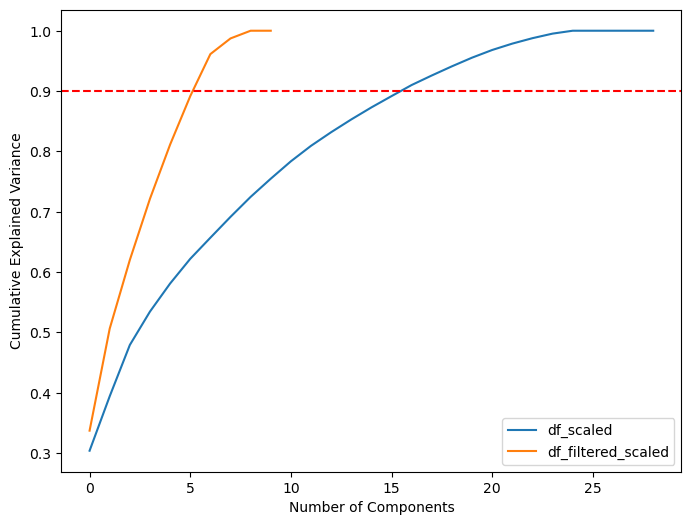

In [39]:
# Create two PCA objects
from sklearn.decomposition import PCA
pca1 = PCA()
pca2 = PCA()

# Fit PCA on your data
pca1.fit(df_scaled)
pca2.fit(df_filtered_scaled)

# Calculate cumulative explained variance for df_scaled
cumulative_explained_variance_scaled = np.cumsum(pca1.explained_variance_ratio_)

# Calculate cumulative explained variance for df_filtered_scaled
cumulative_explained_variance_filtered_scaled = np.cumsum(pca2.explained_variance_ratio_)

# Plot the cumulative explained variance for df_scaled
plt.figure(figsize=(8,6))
plt.plot(range(len(cumulative_explained_variance_scaled)), cumulative_explained_variance_scaled, label='df_scaled')

# Plot the cumulative explained variance for df_filtered_scaled
plt.plot(range(len(cumulative_explained_variance_filtered_scaled)), cumulative_explained_variance_filtered_scaled, label='df_filtered_scaled')

# Add a horizontal line at 90% cumulative explained variance
plt.axhline(y=0.9, color='r', linestyle='--')

plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.legend()
plt.show()

##### Based on the scree plot for df_scaled, a variance of 80% to 90% is achieved with 4 or 5 principal components. For df_filtered_scaled, a variance of 70% to 80% is achieved with 8 or 9 principal components. In PCA, it is desirable to retain a variance between 70% and 90% to capture a significant portion of the data's information while reducing dimensionality.

In [40]:
# perform PCA
from sklearn.decomposition import PCA

# Create two PCA objects
pca1 = PCA(n_components=8)
pca2 = PCA(n_components=5)

# pca for df_scaled
df_scaled_pca = pca1.fit_transform(df_scaled)

#pca for df_filtered_scaled
df_filtered_scaled_pca = pca2.fit_transform(df_filtered_scaled)

# Access the principal components for df_scaled
principal_components_scaled = pca1.components_

# Access the explained variance ratio for df_scaled
explained_variance_ratio_scaled = pca1.explained_variance_ratio_



print("Explained Variance Ratio for df_scaled:")
print(explained_variance_ratio_scaled)
print()

# Access the principal components for df_filtered_scaled
principal_components_filtered_scaled = pca2.components_

# Access the explained variance ratio for df_filtered_scaled
explained_variance_ratio_filtered_scaled = pca2.explained_variance_ratio_


print("Explained Variance Ratio for df_filtered_scaled:")
print(explained_variance_ratio_filtered_scaled)
print()


Explained Variance Ratio for df_scaled:
[0.30409483 0.09027177 0.08496385 0.05532586 0.04647266 0.04092261
 0.03492834 0.03453844]

Explained Variance Ratio for df_filtered_scaled:
[0.3373341  0.169114   0.11378058 0.10137992 0.08972968]



Looking at the explained variance ratio (EVR) for the df_scaled dataset, the first component explains 30.4% of the variance, while the remaining seven components account for 39.2%, 8.5%, 5.5%, 4.6%, 4.1%, 3.5%, and 3.5% respectively. This suggests that the first component is contributing a substantial amount of information, but there is still a considerable amount of information distributed across the remaining components.

On the other hand, in the df_filtered_scaled dataset, the first component explains a significantly larger proportion of the variance, at 33.7%. The next four components account for 16.9%, 11.4%, 10.1%, and 8.9% respectively. This represents a more substantial proportion of the total variance explained by the first few components, indicating that this dataset may have a lower effective dimensionality.

Based on the above analysis, it would seem that the df_filtered_scaled dataset may be a better choice for further analysis or modeling. The reason for this is that a smaller number of components explain a larger proportion of the variance, meaning that we retain more information while reducing dimensionality. In other words, df_filtered_scaled is likely a more efficiently compressed representation of our data.

In [41]:
# Create DataFrame for pca1 results
pca1_df = pd.DataFrame(data=df_scaled_pca, columns=[f"PC{i+1}" for i in range(df_scaled_pca.shape[1])])

# Create DataFrame for pca2 results
pca2_df = pd.DataFrame(data=df_filtered_scaled_pca, columns=[f"PC{i+1}" for i in range(df_filtered_scaled_pca.shape[1])])



In [42]:
pca1_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
0,4.778571,-0.430296,-0.228633,3.308631,-0.395002,-0.053076,0.122814,0.129053
1,-2.945826,0.206716,-0.740620,-0.936778,-0.661417,-0.788078,0.610381,0.123476
2,1.776011,-1.490876,-0.589329,-0.034828,-0.033793,0.094404,-0.950281,0.441278
3,-2.915125,0.292053,-1.019002,-0.499680,0.903884,0.209211,-0.966670,0.166078
4,-0.375717,-1.210242,0.597056,-1.060348,0.003743,-0.091647,0.541674,-0.903428


In [43]:
pca2_df.head()

,PC1,PC2,PC3,PC4,PC5
0,3.109039,-0.958371,-0.196529,-1.800031,-0.853496
1,-1.810221,-0.257530,1.794192,-0.027004,-1.575052
2,1.379175,0.009814,-0.661939,0.445606,-1.107744
3,-2.013692,-0.876450,-0.649741,1.687533,-0.179043
4,-0.307499,0.735736,0.636703,1.548891,1.099736


We got four dataframes 
1. df_scaled
2. df_filtered_scaled
3. pca1_df ( PCA of df_scaled data with n = 8)
4. pca2_df (PCA of df_filtered_scaled data with n = 5)

# Stage1
# Clustering 

We now have four dataframes: two original dataframes (df_scaled and df_filtered_scaled) and two dimensionality-reduced dataframes using PCA (pca1_df and pca2_df). Our next step is to segment customers by implementing various clustering algorithms. Specifically, we will utilize K-Means++, Hierarchical Clustering, and DBSCAN.

Here's a brief overview of these three algorithms:

1. K-Means++: This is an extension of the K-Means clustering algorithm. In standard K-Means, the initial centers are randomly chosen which may lead to sub-optimal solutions. K-Means++ improves upon this by choosing initial centers in a way that accelerates convergence. This means that you get to the optimal solution faster.

2. Hierarchical Clustering: This is a type of clustering algorithm where the objective is to create a hierarchy of clusters. It starts with each object in its own cluster and then merges these atomic clusters into larger and larger clusters, until all objects are in a single cluster or a termination condition is met.

3. DBSCAN (Density-Based Spatial Clustering of Applications with Noise): This is a density-based clustering algorithm, which groups together points in high-density areas and identifies points in low-density areas as noise. It's different from K-Means and Hierarchical Clustering as it doesn’t require the user to specify the number of clusters.

### K-Means++

In the next step of our analysis, we will be using the Elbow Method and Within-Cluster-Sum-of-Squares (WCSS) to determine the optimal number of clusters for the K-Means++ algorithm.

Here's a brief explanation of these concepts:

* Elbow Method: This method involves running the K-Means algorithm multiple times over a loop, with an increasing number of cluster choice and then plotting a clustering score as a function of the number of clusters. The score could be within-cluster variance, average silhouette, or any other internal clustering validation indices. The optimal number of clusters is usually where the change in the clustering score begins to diminish, often called the "elbow" in the plot.

* Within-Cluster-Sum-of-Squares (WCSS): WCSS is a measure of the compactness of the clusters. It calculates the total distance of data points from their respective cluster centroids. The goal is to minimise this distance, as it means that the data points are closer to their centroids and hence, better clustered. However, as the number of clusters increases, the WCSS will always decrease. That's where the Elbow Method comes in handy, as it helps identify the point at which the rate of decrease sharply shifts, which is a reasonable balance between maximum compression of the data using minimal clusters and the precision of the data distribution.

By using the Elbow method with WCSS, we can determine an appropriate number of clusters for our K-Means++ algorithm without excessive computation. The optimal number of clusters is where we start to get diminishing returns in terms of reducing the WCSS, which is visually represented as an 'elbow' in the plot.

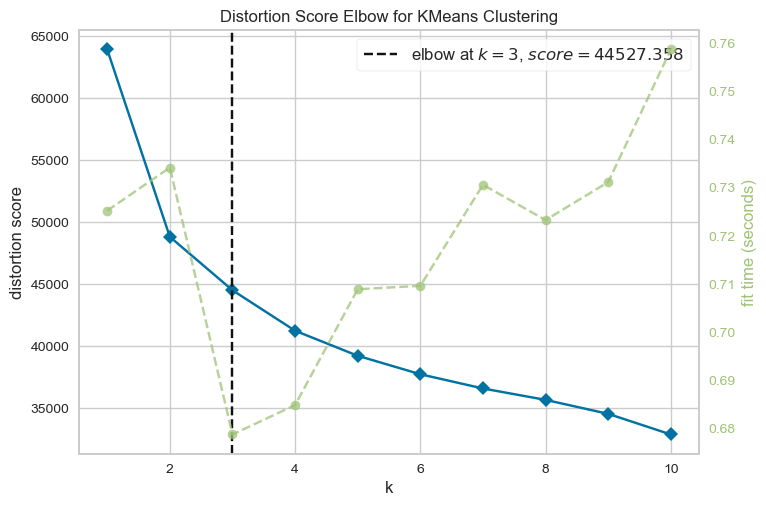

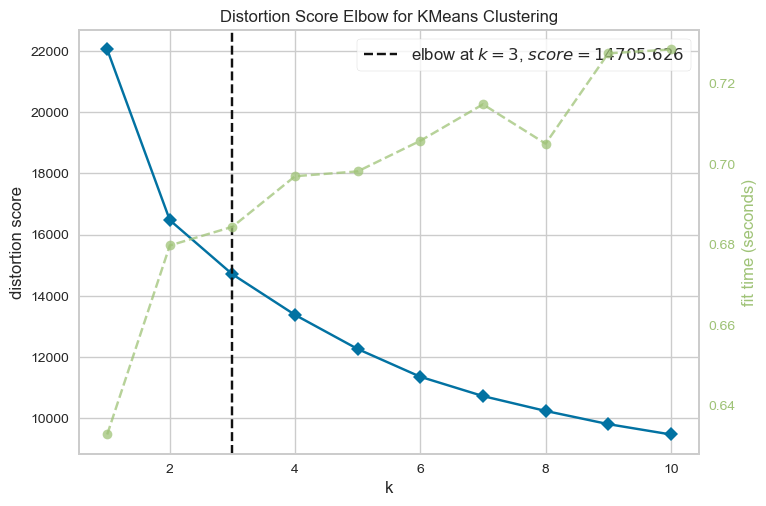

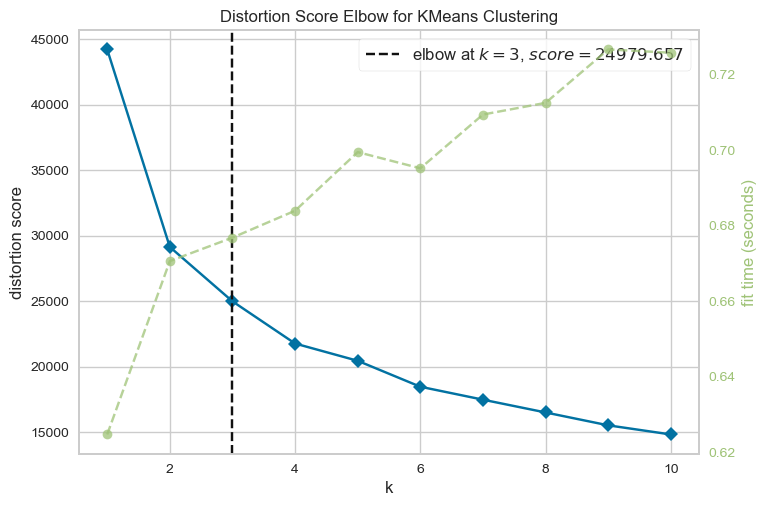

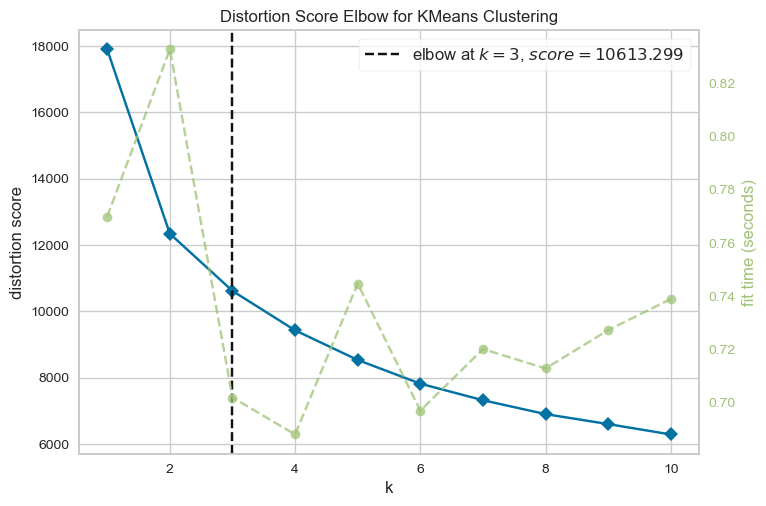

In [46]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

# Create a dictionary with your dataframes
dataframes = {
    'df_scaled': df_scaled,
    'df_filtered_scaled': df_filtered_scaled,
    'pca1_df': pca1_df,
    'pca2_df': pca2_df,
}

for name, df in dataframes.items():
    model = KMeans(init='k-means++', max_iter=300, n_init=10, random_state=0)
    visualizer = KElbowVisualizer(model, k=(1,11))

    visualizer.fit(df)  # Fit the data to the visualizer
    
    visualizer.show()  # Finalize and render the figure


##### Got K 3 for all dataframes

In [47]:
df_scaled = pd.DataFrame(df_scaled)
df_filtered_scaled = pd.DataFrame(df_filtered_scaled)

In [48]:
import plotly.graph_objects as go
from sklearn.cluster import KMeans

dataframes = {
    'df_scaled': df_scaled,
    'df_filtered_scaled': df_filtered_scaled,
    'pca1_df': pca1_df,
    'pca2_df': pca2_df,
}

for name, df in dataframes.items():
    model = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=9)
    y_means = model.fit_predict(df)

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.loc[y_means == 0, df.columns[0]], y=df.loc[y_means == 0, df.columns[1]], 
                             mode='markers', name='Cluster 1'))
    fig.add_trace(go.Scatter(x=df.loc[y_means == 1, df.columns[0]], y=df.loc[y_means == 1, df.columns[1]], 
                             mode='markers', name='Cluster 2'))
    fig.add_trace(go.Scatter(x=df.loc[y_means == 2, df.columns[0]], y=df.loc[y_means == 2, df.columns[1]], 
                             mode='markers', name='Cluster 3'))
    fig.add_trace(go.Scatter(x=model.cluster_centers_[:, 0], y=model.cluster_centers_[:, 1], 
                             mode='markers', name='Centroids', marker=dict(size=12, line=dict(width=2,color='DarkSlateGrey'))))
    
    fig.update_layout(title=f'Clusters for {name}', 
                      xaxis=dict(title='Feature 1' if 'pca' not in name else 'Principal Component 1'),
                      yaxis=dict(title='Feature 2' if 'pca' not in name else 'Principal Component 2'))
    fig.show()


##### The scatter plots of PCA1 and PCA2 show that the data points are well-distributed into distinct groups, indicating that the PCA transformation effectively captured the underlying structure of the data. In contrast, the scatter plots of the scaled DF and DF_filtered reveal more noise and lack clear clustering patterns.

##### Moving forward, it is advisable to focus the analysis on PCA1 and PCA2 to gain further insights and perform subsequent clustering or classification tasks. These transformed components contain the most meaningful information from the original data while reducing noise and dimensionality. This approach allows for a more concise and accurate representation of the data, facilitating more effective analysis and decision-making.

### Validation K-Means++ using Silhouette Score

The silhouette score measures how similar an object is to its own cluster compared to other clusters. The silhouette score ranges from -1 to 1. If it is high, the object is well-matched to its own cluster and poorly matched to neighboring clusters.

For pca1_df, n_clusters = 2, the average silhouette_score is : 0.3390445077860978
For pca1_df, n_clusters = 3, the average silhouette_score is : 0.31803962197673913
For pca1_df, n_clusters = 4, the average silhouette_score is : 0.2625098126276704


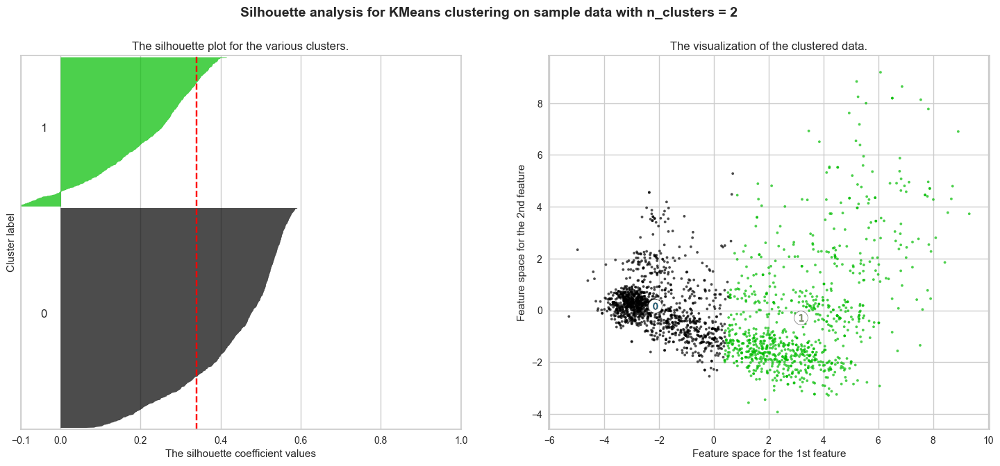

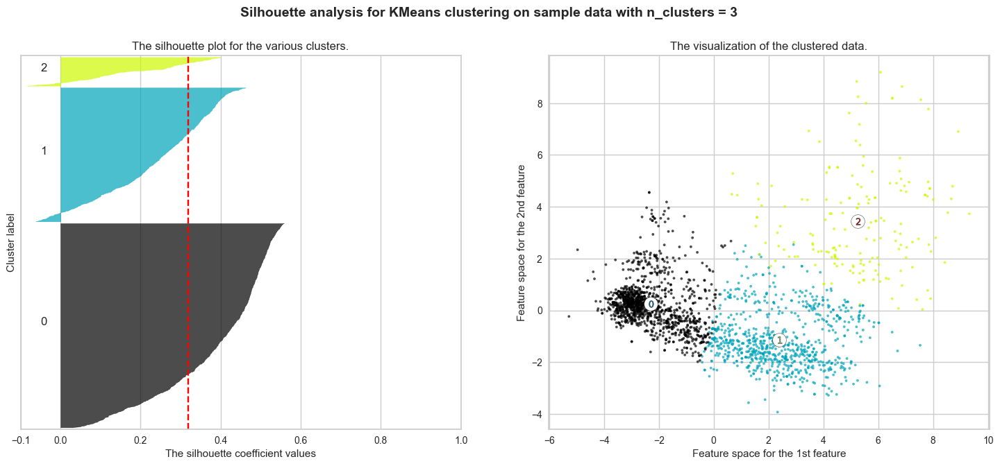

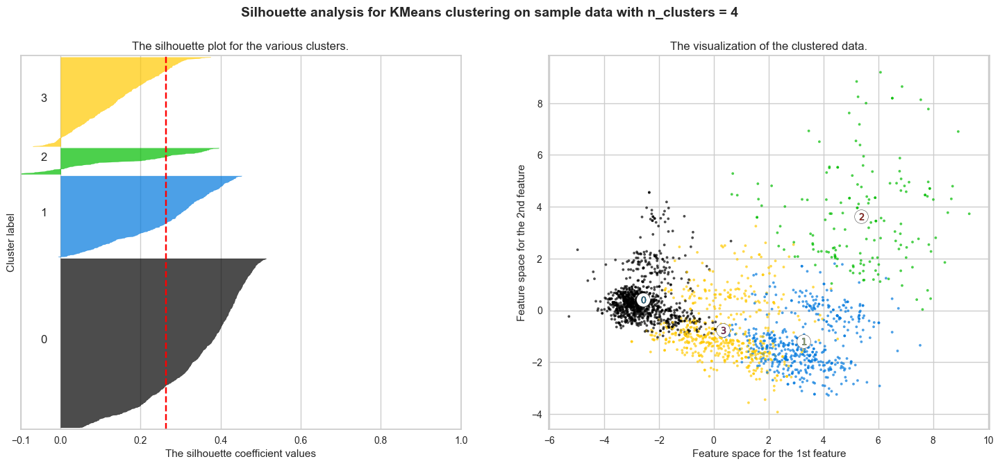

For pca2_df, n_clusters = 2, the average silhouette_score is : 0.27939838848327153
For pca2_df, n_clusters = 3, the average silhouette_score is : 0.21310144685275684
For pca2_df, n_clusters = 4, the average silhouette_score is : 0.1898441675229436


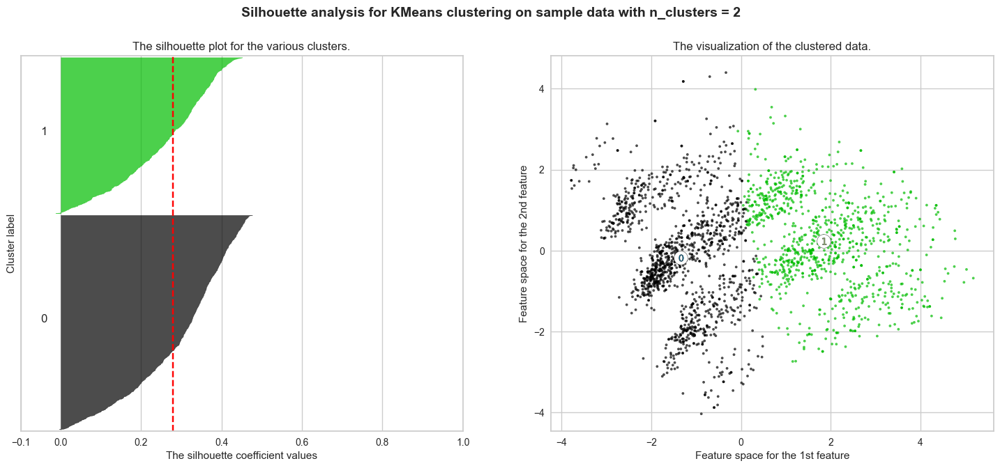

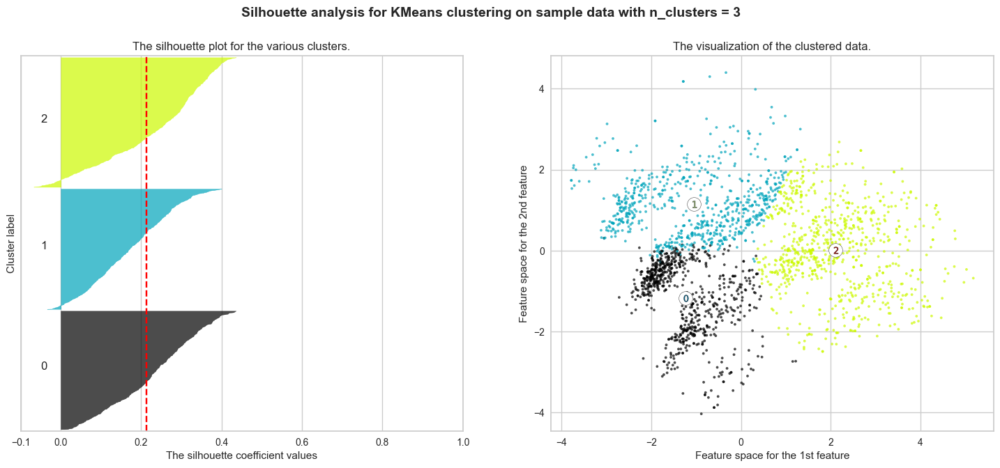

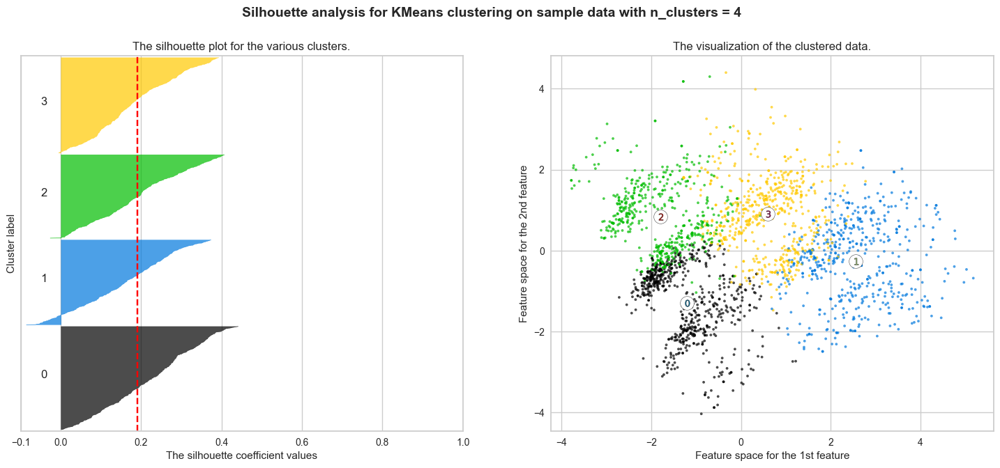

In [42]:
from sklearn.metrics import silhouette_samples
from sklearn.metrics import silhouette_score

from matplotlib import cm


pca_dfs = {
    'pca1_df': pca1_df,
    'pca2_df': pca2_df,
}

# Define the range of clusters to check
clusters_range = range(2, 5)

for name, df in pca_dfs.items():
    for k in clusters_range:
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)
        
        # The 1st subplot is the silhouette plot
        ax1.set_xlim([-0.1, 1])
        ax1.set_ylim([0, len(df) + (k + 1) * 10])

        model = KMeans(n_clusters=k, init='k-means++', max_iter=300, n_init=10, random_state=0)
        labels = model.fit_predict(df)
        silhouette_avg = silhouette_score(df, labels)
        
        print(f"For {name}, n_clusters = {k}, the average silhouette_score is : {silhouette_avg}")

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(df, labels)

        y_lower = 10
        for i in range(k):
            ith_cluster_silhouette_values = \
                sample_silhouette_values[labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / k)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
            y_lower = y_upper + 10

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(labels.astype(float) / k)
        ax2.scatter(df.iloc[:, 0], df.iloc[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Draw white circles at cluster centers
        centers = model.cluster_centers_
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % k),
                     fontsize=14, fontweight='bold')
    plt.show()


The clustering analysis using pca1_df with 3 clusters achieved a moderately good silhouette score of 0.315. This indicates a reasonable level of separation and coherence among the identified clusters. Compared to the alternative pca2_df clustering solution, which obtained a lower silhouette score of 0.213, pca1_df demonstrates a stronger clustering structure and better differentiation between the groups. However, it's essential to consider the specific context and domain knowledge when evaluating the quality of the clustering results. Further validation and exploration of the clusters using additional techniques are recommended to ensure the robustness and reliability of the chosen solution.

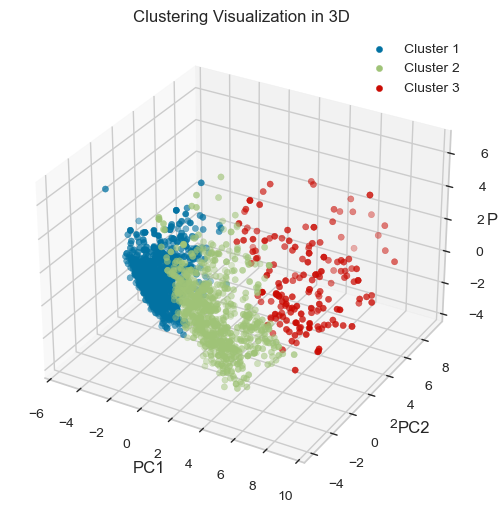

In [50]:
# final pca1_df 3d visual

from mpl_toolkits.mplot3d import Axes3D

# Performing k-means clustering
model = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=0)
pca1_df['Cluster'] = model.fit_predict(pca1_df)

# Create a 3D plot
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot for each cluster
for cluster in range(3):
    cluster_data = pca1_df[pca1_df['Cluster'] == cluster]
    ax.scatter(cluster_data['PC1'], cluster_data['PC2'], cluster_data['PC3'], label=f'Cluster {cluster+1}')

# Set labels and title
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('Clustering Visualization in 3D')

# Add legend
ax.legend()

# Show the plot
plt.show()


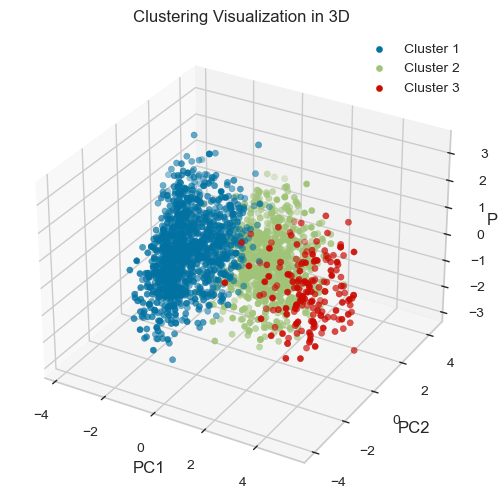

In [51]:
# final pca2_df 3d visual



# Performing k-means clustering
model = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=0)
pca2_df['Cluster'] = model.fit_predict(pca2_df)

# Create a 3D plot
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot for each cluster
for cluster in range(3):
    cluster_data = pca2_df[pca1_df['Cluster'] == cluster]
    ax.scatter(cluster_data['PC1'], cluster_data['PC2'], cluster_data['PC3'], label=f'Cluster {cluster+1}')

# Set labels and title
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('Clustering Visualization in 3D')

# Add legend
ax.legend()

# Show the plot
plt.show()


In [52]:
from plotly.subplots import make_subplots
# Counting the number of customers in each cluster for pca1_df
pca1_df_counts = pca1_df['Cluster'].value_counts().reset_index()
pca1_df_counts.columns = ['Cluster', 'Count']
pca1_df_counts = pca1_df_counts.sort_values('Cluster')

# Counting the number of customers in each cluster for pca2_df
pca2_df_counts = pca2_df['Cluster'].value_counts().reset_index()
pca2_df_counts.columns = ['Cluster', 'Count']
pca2_df_counts = pca2_df_counts.sort_values('Cluster')

# Creating subplot figure
fig = make_subplots(rows=1, cols=2, subplot_titles=("pca1_df", "pca2_df"))

# Adding bar plot for pca1_df
fig.add_trace(go.Bar(x=pca1_df_counts['Cluster'], y=pca1_df_counts['Count'], name="Count", text=pca1_df_counts['Count'],
                     textposition='auto'), row=1, col=1)

# Adding bar plot for pca2_df
fig.add_trace(go.Bar(x=pca2_df_counts['Cluster'], y=pca2_df_counts['Count'], name="Count", text=pca2_df_counts['Count'],
                     textposition='auto'), row=1, col=2)

# Update layout and axis labels
fig.update_layout(title="Distribution of Customers in Clusters",
                  xaxis=dict(title="Cluster"),
                  yaxis=dict(title="Count"),
                  showlegend=False)

# Show the plot
fig.show()

## Hierarchical Clustering

Hierarchical clustering is a clustering algorithm that seeks to build a hierarchy of clusters. It does not require a predefined number of clusters but instead forms clusters by recursively merging or splitting them based on the similarity between data points.

Here are the steps involved in performing hierarchical clustering:

* Calculate the pairwise distance or similarity matrix between data points.
* Each data point is initially considered as a separate cluster.
* Merge the two closest clusters based on a distance metric (e.g., Euclidean distance, Manhattan distance) to form a new cluster.
* Update the similarity matrix with the distances between the new cluster and the remaining clusters.
* Repeat steps 3 and 4 until all data points are merged into a single cluster or until a desired number of clusters is reached.
* The result is a dendrogram, which is a tree-like structure representing the hierarchical clustering.

In [46]:
pca1_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,Cluster
0,4.778575,-0.431022,-0.233758,3.299100,-0.422712,-0.095591,0.152742,0.249067,1
1,-2.945829,0.206513,-0.741823,-0.939268,-0.662957,-0.797031,0.577378,0.123228,0
2,1.776005,-1.490874,-0.587736,-0.031005,-0.019317,0.114025,-0.932182,0.484745,1
3,-2.915123,0.291962,-1.019391,-0.501065,0.898932,0.202037,-0.951736,0.237706,0
4,-0.375708,-1.210172,0.597005,-1.059922,-0.009606,-0.098461,0.544075,-0.898794,0


In [47]:
pca2_df.head()

,PC1,PC2,PC3,PC4,PC5,Cluster
0,3.109039,-0.958371,-0.196529,-1.800031,-0.853496,2
1,-1.810221,-0.257530,1.794192,-0.027004,-1.575052,1
2,1.379175,0.009814,-0.661939,0.445606,-1.107744,2
3,-2.013692,-0.876450,-0.649741,1.687533,-0.179043,0
4,-0.307499,0.735736,0.636703,1.548891,1.099736,1


In [48]:
#drop cluster feature from pca1_df and pca1_df

pca1_df.drop(columns=['Cluster'], inplace=True)
pca2_df.drop(columns=['Cluster'], inplace=True)


In [54]:
from sklearn.cluster import AgglomerativeClustering

# Perform hierarchical clustering on pca1_df
model1 = AgglomerativeClustering(n_clusters=3)
cluster_labels1 = model1.fit_predict(pca1_df)

# Print the cluster labels
print("Cluster labels for pca1_df:")
print(cluster_labels1)



# Perform hierarchical clustering on pca2_df
model2 = AgglomerativeClustering(n_clusters=3)
cluster_labels2 = model2.fit_predict(pca2_df)

# Print the cluster labels
print("Cluster labels for pca2_df:")
print(cluster_labels2)


Cluster labels for pca1_df:
[0 1 0 ... 0 2 2]
Cluster labels for pca2_df:
[1 0 1 ... 1 2 2]


In [55]:
dataframes = {
    'pca1_df': pca1_df,
    'pca2_df': pca2_df,
}

for name, df in dataframes.items():
    model = AgglomerativeClustering(n_clusters=3)
    cluster_labels = model.fit_predict(df)

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.iloc[cluster_labels == 0, 0], y=df.iloc[cluster_labels == 0, 1], 
                             mode='markers', name='Cluster 1'))
    fig.add_trace(go.Scatter(x=df.iloc[cluster_labels == 1, 0], y=df.iloc[cluster_labels == 1, 1], 
                             mode='markers', name='Cluster 2'))
    fig.add_trace(go.Scatter(x=df.iloc[cluster_labels == 2, 0], y=df.iloc[cluster_labels == 2, 1], 
                             mode='markers', name='Cluster 3'))
    
    fig.update_layout(title=f'Clusters for {name}', 
                      xaxis=dict(title='Principal Component 1'),
                      yaxis=dict(title='Principal Component 2'))
    fig.show()

#### Based on the observation of the scatter plots, it appears that the clusters created by hierarchical clustering showed significant overlap. This suggests that the algorithm was not able to generate well-separated and distinct clusters for this particular dataset. Consequently, the effectiveness of hierarchical clustering in creating meaningful clusters for this dataset is questionable. Further analysis and alternative clustering algorithms may be necessary to achieve better cluster separation and differentiation.

## DBSCAN (Density-Based Spatial Clustering of Applications with Noise)

* DBSCAN is a density-based clustering algorithm that groups together data points based on their density in the feature space.
* It does not require specifying the number of clusters in advance and can discover clusters of arbitrary shape.
* DBSCAN defines clusters as dense regions separated by sparser regions of low-density data points.
* It works by defining a neighborhood around each data point and expanding the clusters by connecting neighboring points that have a sufficient density.
* Outliers or noise points that do not belong to any cluster are identified as points with low-density neighborhoods.
* DBSCAN's performance is influenced by two key parameters: epsilon (ε), which defines the radius of the neighborhood, and min_samples, which sets the minimum number of points required to form a dense region.

In [56]:
from sklearn.cluster import DBSCAN

# Perform DBSCAN clustering on pca1_df
dbscan1 = DBSCAN(eps=0.5, min_samples=5)
cluster_labels1_dbscan = dbscan1.fit_predict(pca1_df)

# Print the cluster labels
print("DBSCAN cluster labels for pca1_df:")
print(cluster_labels1_dbscan)

# Perform DBSCAN clustering on pca2_df
dbscan2 = DBSCAN(eps=0.5, min_samples=5)
cluster_labels2_dbscan = dbscan2.fit_predict(pca2_df)

# Print the cluster labels
print("DBSCAN cluster labels for pca2_df:")
print(cluster_labels2_dbscan)


DBSCAN cluster labels for pca1_df:
[-1 -1 -1 ... -1 -1 -1]
DBSCAN cluster labels for pca2_df:
[-1 -1  0 ... -1 -1 -1]


In [57]:
from sklearn.cluster import DBSCAN

# Create an instance of DBSCAN to create non-spherical clusters based on data density
# For pca1_df
db1 = DBSCAN(eps=0.726, min_samples=26)

# Fit to the dimensionality reduced dataset
db1.fit(pca1_df)

# Identify the clusters
clusters1 = db1.labels_

# Display metrics/sample
n_clusters1_ = len(set(clusters1)) - (1 if -1 in clusters1 else 0)
n_noise1_ = list(clusters1).count(-1)

print('Cluster Predictions for pca1_df')
print('-------------------------------')
print("Number of clusters: %d" % n_clusters1_)
print("Number of noise points: %d" % n_noise1_)
print('Number of points per cluster:')
for i in range(n_clusters1_):
    print('Cluster', i, ':', len(clusters1[clusters1==i]))


# Repeat the process for pca2_df
db2 = DBSCAN(eps=0.726, min_samples=26)

# Fit to the dimensionality reduced dataset
db2.fit(pca2_df)

# Identify the clusters
clusters2 = db2.labels_

# Display metrics/sample
n_clusters2_ = len(set(clusters2)) - (1 if -1 in clusters2 else 0)
n_noise2_ = list(clusters2).count(-1)

print('\nCluster Predictions for pca2_df')
print('-------------------------------')
print("Number of clusters: %d" % n_clusters2_)
print("Number of noise points: %d" % n_noise2_)
print('Number of points per cluster:')
for i in range(n_clusters2_):
    print('Cluster', i, ':', len(clusters2[clusters2==i]))


Cluster Predictions for pca1_df
-------------------------------
Number of clusters: 0
Number of noise points: 2205
Number of points per cluster:

Cluster Predictions for pca2_df
-------------------------------
Number of clusters: 5
Number of noise points: 1947
Number of points per cluster:
Cluster 0 : 88
Cluster 1 : 48
Cluster 2 : 38
Cluster 3 : 36
Cluster 4 : 48


#### Hyperparamater Tunning
##### Check Best eps and min_sample 

In [58]:
from sklearn.metrics import silhouette_score

# Define the parameter space
eps_values = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
min_samples_values = [5, 10, 15, 20, 25, 30]

# Initialize variables to store the best parameters
best_eps = None
best_min_samples = None
best_silhouette = -1

# Perform the grid search
for eps in eps_values:
    for min_samples in min_samples_values:
        db = DBSCAN(eps=eps, min_samples=min_samples)
        clusters = db.fit_predict(pca1_df)

        # Check if more than one cluster is created
        if len(set(clusters)) > 1:
            silhouette = silhouette_score(pca1_df, clusters)

            if silhouette > best_silhouette:
                best_eps = eps
                best_min_samples = min_samples
                best_silhouette = silhouette

print("Best eps:", best_eps)
print("Best min_samples:", best_min_samples)


Best eps: 1.0
Best min_samples: 20


In [59]:
# Define the parameter space
eps_values = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
min_samples_values = [5, 10, 15, 20, 25, 30]

# Initialize variables to store the best parameters
best_eps = None
best_min_samples = None
best_silhouette = -1

# Perform the grid search
for eps in eps_values:
    for min_samples in min_samples_values:
        db = DBSCAN(eps=eps, min_samples=min_samples)
        clusters = db.fit_predict(pca2_df)

        # Check if more than one cluster is created
        if len(set(clusters)) > 1:
            silhouette = silhouette_score(pca2_df, clusters)

            if silhouette > best_silhouette:
                best_eps = eps
                best_min_samples = min_samples
                best_silhouette = silhouette

print("Best eps:", best_eps)
print("Best min_samples:", best_min_samples)

Best eps: 1.0
Best min_samples: 5


Remodel according to above values 

In [60]:
# Create an instance of DBSCAN to create non-spherical clusters based on data density
# For pca1_df
db1 = DBSCAN(eps=1, min_samples=20)

# Fit to the dimensionality reduced dataset
db1.fit(pca1_df)

# Identify the clusters
clusters1 = db1.labels_

# Display metrics/sample
n_clusters1_ = len(set(clusters1)) - (1 if -1 in clusters1 else 0)
n_noise1_ = list(clusters1).count(-1)

print('Cluster Predictions for pca1_df')
print('-------------------------------')
print("Number of clusters: %d" % n_clusters1_)
print("Number of noise points: %d" % n_noise1_)
print('Number of points per cluster:')
for i in range(n_clusters1_):
    print('Cluster', i, ':', len(clusters1[clusters1==i]))



Cluster Predictions for pca1_df
-------------------------------
Number of clusters: 3
Number of noise points: 1798
Number of points per cluster:
Cluster 0 : 246
Cluster 1 : 77
Cluster 2 : 84


In [61]:
# Create an instance of DBSCAN to create non-spherical clusters based on data density
# For pca1_df
db1 = DBSCAN(eps=1, min_samples=5)

# Fit to the dimensionality reduced dataset
db1.fit(pca2_df)

# Identify the clusters
clusters1 = db1.labels_

# Display metrics/sample
n_clusters1_ = len(set(clusters1)) - (1 if -1 in clusters1 else 0)
n_noise1_ = list(clusters1).count(-1)

print('Cluster Predictions for pca1_df')
print('-------------------------------')
print("Number of clusters: %d" % n_clusters1_)
print("Number of noise points: %d" % n_noise1_)
print('Number of points per cluster:')
for i in range(n_clusters1_):
    print('Cluster', i, ':', len(clusters1[clusters1==i]))


Cluster Predictions for pca1_df
-------------------------------
Number of clusters: 43
Number of noise points: 279
Number of points per cluster:
Cluster 0 : 24
Cluster 1 : 219
Cluster 2 : 60
Cluster 3 : 95
Cluster 4 : 229
Cluster 5 : 41
Cluster 6 : 163
Cluster 7 : 21
Cluster 8 : 94
Cluster 9 : 24
Cluster 10 : 33
Cluster 11 : 36
Cluster 12 : 98
Cluster 13 : 13
Cluster 14 : 129
Cluster 15 : 56
Cluster 16 : 59
Cluster 17 : 28
Cluster 18 : 99
Cluster 19 : 79
Cluster 20 : 59
Cluster 21 : 25
Cluster 22 : 58
Cluster 23 : 45
Cluster 24 : 7
Cluster 25 : 10
Cluster 26 : 7
Cluster 27 : 14
Cluster 28 : 5
Cluster 29 : 5
Cluster 30 : 11
Cluster 31 : 12
Cluster 32 : 6
Cluster 33 : 9
Cluster 34 : 6
Cluster 35 : 8
Cluster 36 : 5
Cluster 37 : 5
Cluster 38 : 6
Cluster 39 : 8
Cluster 40 : 5
Cluster 41 : 5
Cluster 42 : 5


Based on these results, using DBSCAN with the current parameter settings is not recommended for these datasets. The parameters, especially epsilon and the minimum sample count, should be fine-tuned based on the characteristics of the data. If tuning the parameters doesn't improve the results, it might be more appropriate to use a different clustering algorithm that is more suited to the data's structure. Alternative algorithms to consider could include K-means, Hierarchical Clustering, or Gaussian Mixture Models.

### Conclusive Report on Clustering Analysis

In the course of our exploratory data analysis, we have applied various clustering algorithms, specifically K-means++, Hierarchical Clustering, and DBSCAN, to our datasets: pca1_df and pca2_df. These dataframes represent two distinct sets of principal components derived from our original dataset.

After an exhaustive and iterative process of model tuning and evaluation, we found that the K-means++ algorithm performed the most effectively in revealing the underlying structure of our data. The clusters formed by the K-means++ algorithm were more cohesive and better separated than those generated by the Hierarchical Clustering and DBSCAN algorithms.

To further explore and validate our clustering results from the K-means++ model, we have conducted an in-depth exploratory data analysis (EDA) on the formed clusters for both pca1_df and pca2_df. This process included assessing the distributions, central tendencies, and dispersions of our data within and across the identified clusters.

We also employed visual analytics, creating an interactive dashboard using Power BI. This step greatly facilitated the presentation of our clustering results, enabling us to interactively explore each cluster and their respective properties. This dashboard offered a visually intuitive understanding of the cluster formations and their characteristics, providing significant insights into the structure of our data.

Based on the insights from our EDA and Power BI visualization, we were able to evaluate and compare the clustering results between pca1_df and pca2_df. These evaluations will allow us to ascertain which set of principal components, and consequently, which feature space better represents the structure of our original data.

In conclusion, the application of K-means++ has yielded valuable insights into the hidden structure of our datasets. This, combined with the subsequent EDA and Power BI dashboard creation, has provided us with a comprehensive understanding of our data and will be instrumental in guiding our future data-driven decision-making processes.

## Feature Engineering

##### As a part of our feature engineering strategy, we have enriched the original datasets df1 and df2 by incorporating the cluster assignments from our K-means++ algorithm applied to the respective PCA-transformed dataframes, pca1_df and pca2_df. This additional 'Cluster' feature serves as an indicator of the underlying group structure detected in our high-dimensional datasets, thus providing a valuable source of information for further exploratory data analysis.

##### Subsequently, these enhanced datasets will be visualized in a Power BI dashboard, enabling us to interactively investigate the patterns and relationships within and between the identified clusters. Additionally, these enriched datasets will be employed to develop predictive models, leveraging the newly added 'Cluster' feature to enhance the model's ability to recognize and adapt to the inherent groupings in future data.

##### This method illustrates a cohesive blend of unsupervised learning (clustering) and dimensionality reduction (PCA) techniques that not only assists in revealing the intrinsic structure of our data, but also adds a new dimension for data exploration and modeling.

In [62]:
# Performing k-means clustering
model = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=0)
pca1_df['Cluster'] = model.fit_predict(pca1_df)

# Store the cluster labels
cluster_labels1 = pca1_df['Cluster'].values

# Add cluster labels to the original dataframe df1
df1['Cluster'] = cluster_labels1

# Repeat the same for pca2_df and df2
model = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=0)
pca2_df['Cluster'] = model.fit_predict(pca2_df)

# Store the cluster labels
cluster_labels2 = pca2_df['Cluster'].values

# Add cluster labels to the original dataframe df2
df2['Cluster'] = cluster_labels2


In [58]:
# save in csv_file 

df1.to_csv('group1_pca1.csv', index=False)


df2.to_csv('group2_pca2.csv', index=False)

## Evaluation (EDA)

#### Sum of accepted campaigns by groups 

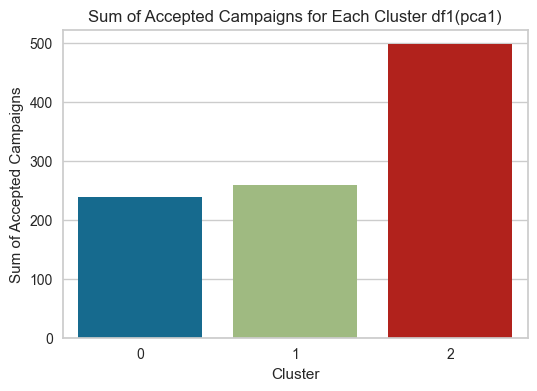

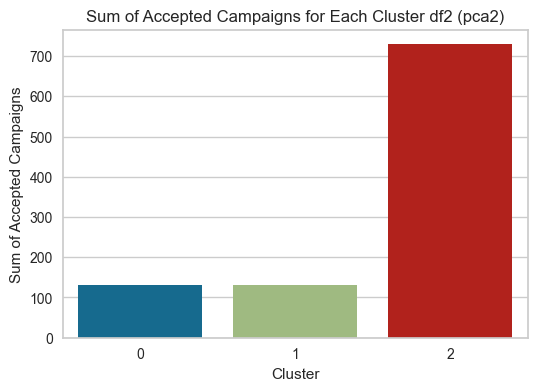

In [59]:
#df1(pca1 group)

plt.figure(figsize=(6, 4))
sns.barplot(x="Cluster", y="accepted_camp", data=df1, estimator=sum, ci=None)
plt.title('Sum of Accepted Campaigns for Each Cluster df1(pca1)')
plt.xlabel('Cluster')
plt.ylabel('Sum of Accepted Campaigns')
plt.show()

#df2(pca2 group)

plt.figure(figsize=(6, 4))
sns.barplot(x="Cluster", y="accepted_camp", data=df2, estimator=sum, ci=None)
plt.title('Sum of Accepted Campaigns for Each Cluster df2 (pca2)')
plt.xlabel('Cluster')
plt.ylabel('Sum of Accepted Campaigns')
plt.show()

#### Income VS Spent by Clusters 

In [63]:
#Create a scatter plot df1
fig = px.scatter(df1, 
                 x="Income", 
                 y="Total_spend",
                 color='Cluster', # Different clusters will have different colors
                 hover_data=['Cluster'], # This will show cluster number on hover
                 title="Income vs Spending by Cluster Group df1(pca1)",
                 labels={
                     "Income": "Income",
                     "Total_spend": "Total Spending",
                     "Cluster": "Cluster Group"
                 },
                 color_discrete_sequence=px.colors.qualitative.D3) # Use a discrete color sequence

fig.show()

#Create a scatter plot df2
fig = px.scatter(df2, 
                 x="Income", 
                 y="Total_spend",
                 color='Cluster', # Different clusters will have different colors
                 hover_data=['Cluster'], # This will show cluster number on hover
                 title="Income vs Spending by Cluster Group df2(pca2)",
                 labels={
                     "Income": "Income",
                     "Total_spend": "Total Spending",
                     "Cluster": "Cluster Group"
                 },
                 color_discrete_sequence=px.colors.qualitative.D3) # Use a discrete color sequence

fig.show()

#### Cluster groups by Total Spend

In [64]:
# Boxplot for 'Total_spend' across different clusters in df1
fig = px.box(df1, 
             x='Cluster', 
             y='Total_spend', 
             color='Cluster',
             labels={'Total_spend': 'Total Spending', 'Cluster': 'Cluster Group'},
             title='Distribution of Total Spending by Cluster Group df1(pca1)',
             color_discrete_sequence=px.colors.qualitative.D3) # Use a discrete color sequence

fig.show()

# Boxplot for 'Total_spend' across different clusters in df2
fig = px.box(df2, 
             x='Cluster', 
             y='Total_spend', 
             color='Cluster',
             labels={'Total_spend': 'Total Spending', 'Cluster': 'Cluster Group'},
             title='Distribution of Total Spending by Cluster Group df2(pca2)',
             color_discrete_sequence=px.colors.qualitative.D3) # Use a discrete color sequence

fig.show()

#### Family Size, Education, Total children vs Group 

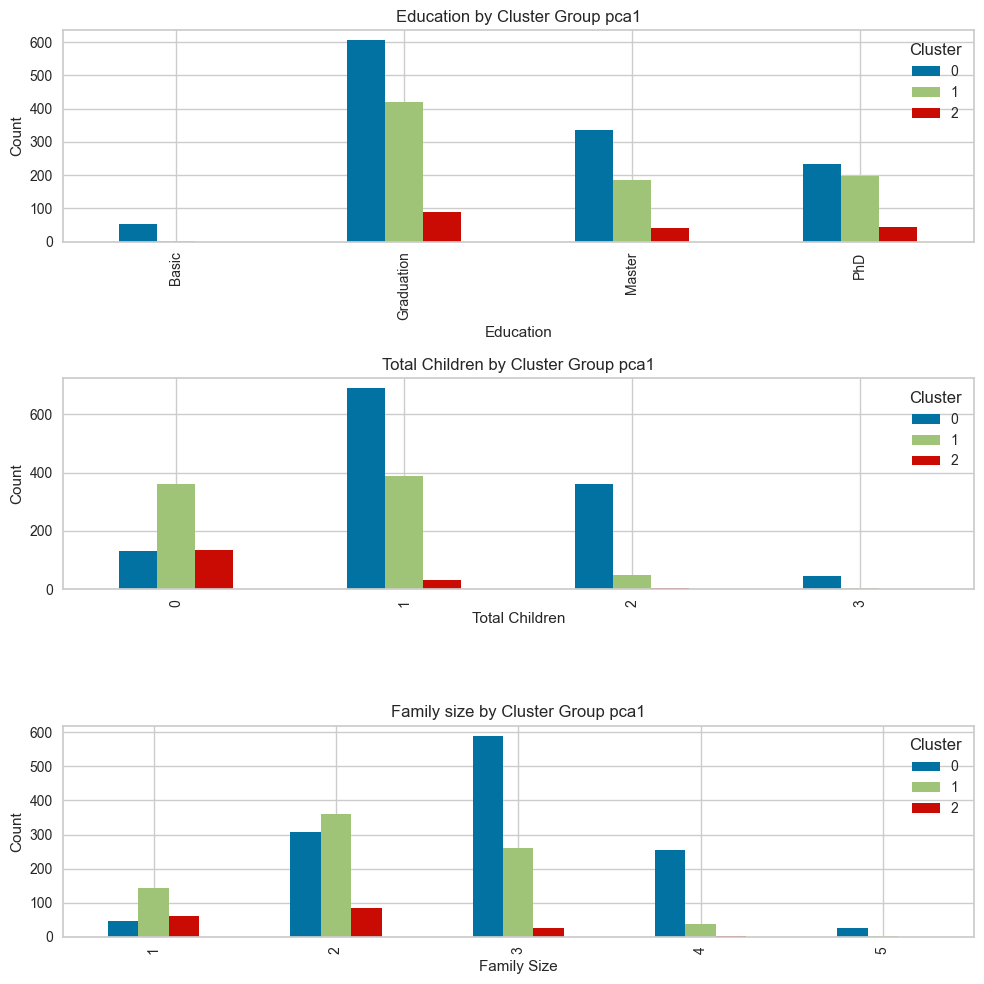

In [62]:
fig, axs = plt.subplots(nrows=3, figsize=(10, 10))

# Plot 'Education' vs 'Cluster'
df1.groupby(['Education', 'Cluster']).size().unstack().plot(kind='bar', ax=axs[0])
axs[0].set_title('Education by Cluster Group pca1')

# Plot 'Total_children' vs 'Cluster'
df1.groupby(['Total_children', 'Cluster']).size().unstack().plot(kind='bar', ax=axs[1])
axs[1].set_title('Total Children by Cluster Group pca1')

# Plot 'Family_size' vs 'Cluster'
df1.groupby(['Family_size', 'Cluster']).size().unstack().plot(kind='bar', ax=axs[2])
axs[2].set_title('Family size by Cluster Group pca1')

# Set x-axis labels
axs[0].set_xlabel('Education')
axs[1].set_xlabel('Total Children')
axs[2].set_xlabel('Family Size')

# Set y-axis labels
axs[0].set_ylabel('Count')
axs[1].set_ylabel('Count')
axs[2].set_ylabel('Count')

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


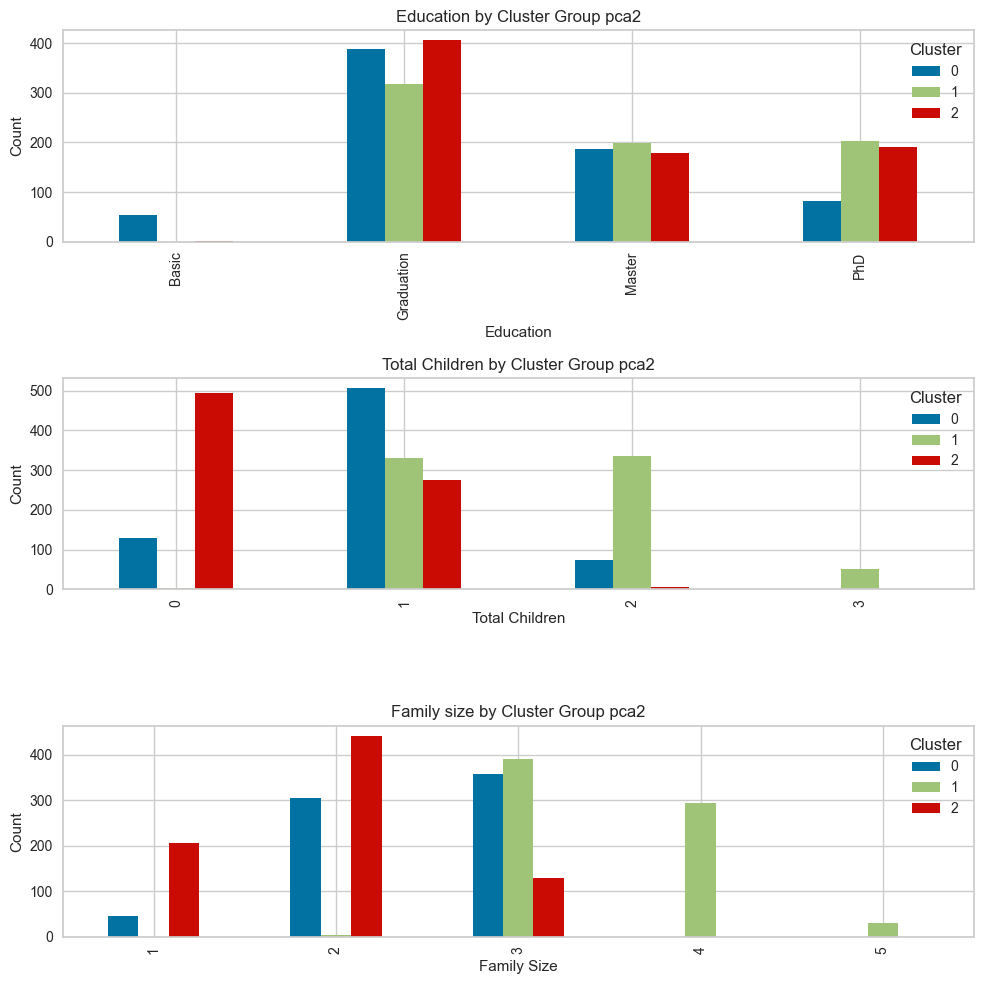

In [63]:
fig, axs = plt.subplots(nrows=3, figsize=(10, 10))

# Plot 'Education' vs 'Cluster'
df2.groupby(['Education', 'Cluster']).size().unstack().plot(kind='bar', ax=axs[0])
axs[0].set_title('Education by Cluster Group pca2')

# Plot 'Total_children' vs 'Cluster'
df2.groupby(['Total_children', 'Cluster']).size().unstack().plot(kind='bar', ax=axs[1])
axs[1].set_title('Total Children by Cluster Group pca2')

# Plot 'Family_size' vs 'Cluster'
df2.groupby(['Family_size', 'Cluster']).size().unstack().plot(kind='bar', ax=axs[2])
axs[2].set_title('Family size by Cluster Group pca2')

# Set x-axis labels
axs[0].set_xlabel('Education')
axs[1].set_xlabel('Total Children')
axs[2].set_xlabel('Family Size')

# Set y-axis labels
axs[0].set_ylabel('Count')
axs[1].set_ylabel('Count')
axs[2].set_ylabel('Count')

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

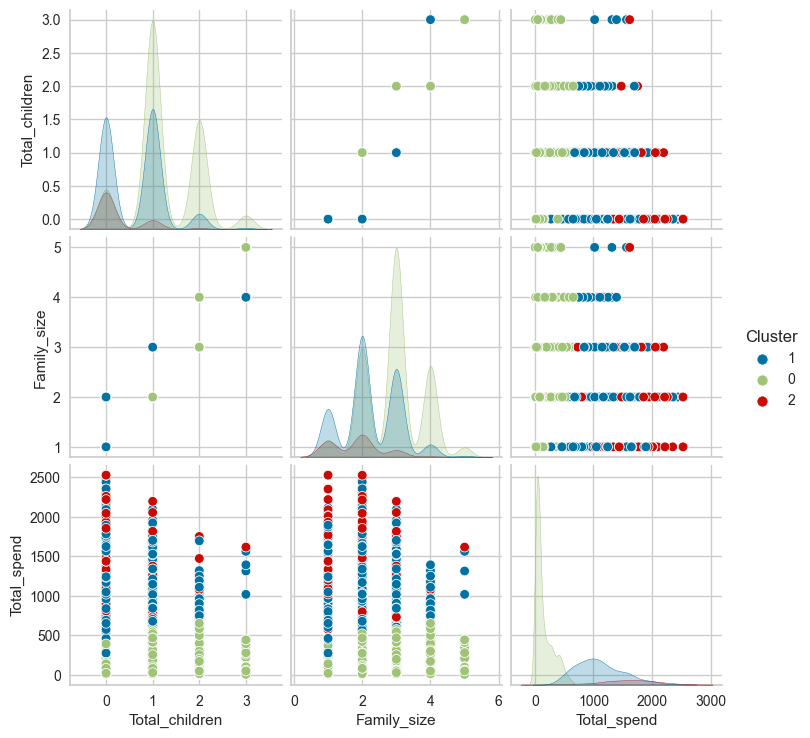

In [64]:

# Subset of features df1
df_subset = df1[['Education', 'Total_children', 'Family_size', 'Total_spend', 'Cluster']]

# Convert 'Cluster' to string type so that pairplot treats it as a categorical variable
df_subset['Cluster'] = df_subset['Cluster'].astype(str)

# Pairplot
sns.pairplot(df_subset, hue='Cluster')
plt.show()


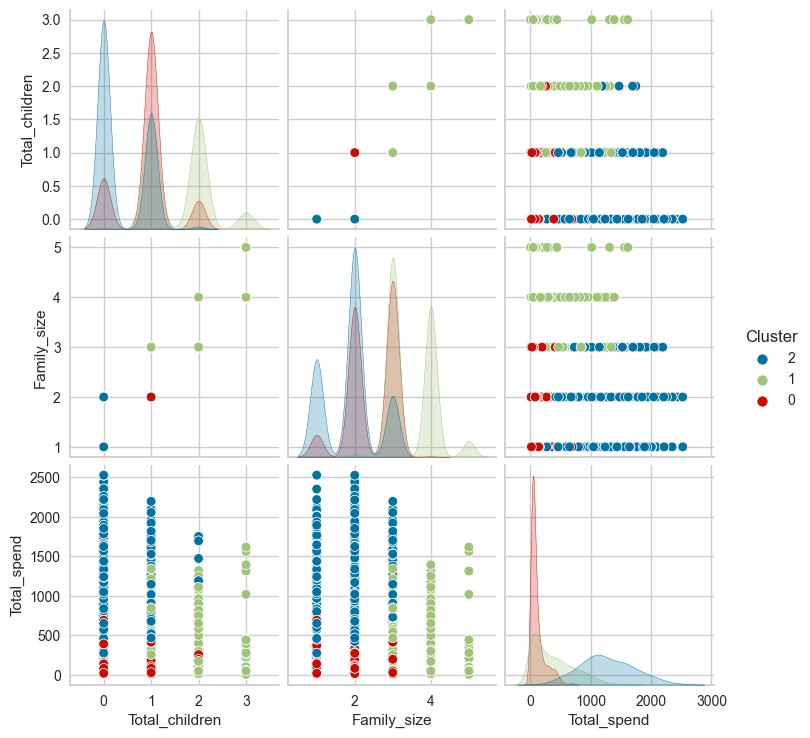

In [65]:
# Subset of features df2
df_subset = df2[['Education', 'Total_children', 'Family_size', 'Total_spend', 'Cluster']]

# Convert 'Cluster' to string type so that pairplot treats it as a categorical variable
df_subset['Cluster'] = df_subset['Cluster'].astype(str)

# Pairplot
sns.pairplot(df_subset, hue='Cluster')
plt.show()

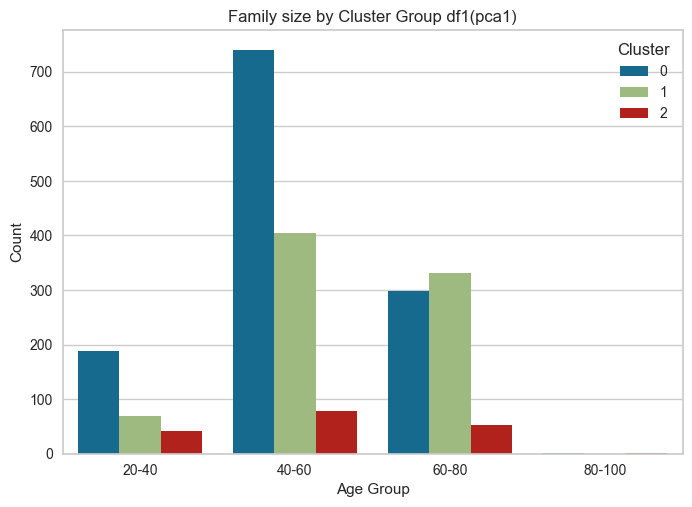

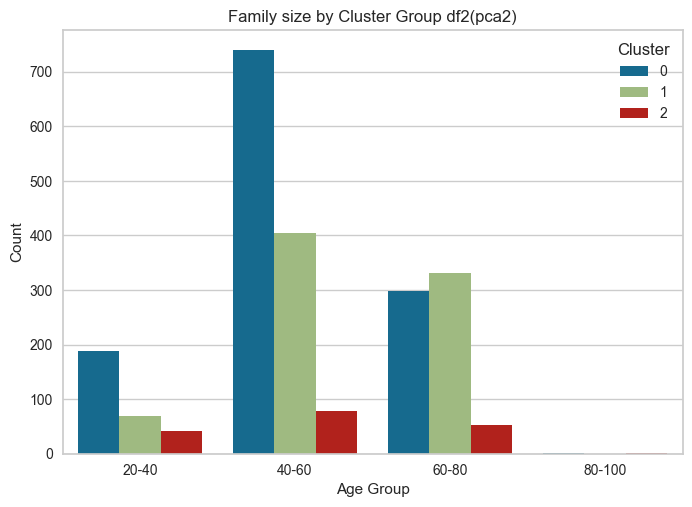

In [66]:
# Define the bin edges and labels for age bins
age_bins = [20, 40, 60, 80, 100]
age_labels = ['20-40', '40-60', '60-80', '80-100']

# Bin the 'Age' variable using pd.cut()
df1['Age_bins'] = pd.cut(df1['Age'], bins=age_bins, labels=age_labels)

# Plot 'Age_bins' vs 'Cluster' using countplot
sns.countplot(data=df1, x='Age_bins', hue='Cluster')
plt.title('Family size by Cluster Group df1(pca1)')
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.show()

# Define the bin edges and labels for age bins df2
age_bins = [20, 40, 60, 80, 100]
age_labels = ['20-40', '40-60', '60-80', '80-100']

# Bin the 'Age' variable using pd.cut()
df2['Age_bins'] = pd.cut(df1['Age'], bins=age_bins, labels=age_labels)

# Plot 'Age_bins' vs 'Cluster' using countplot
sns.countplot(data=df1, x='Age_bins', hue='Cluster')
plt.title('Family size by Cluster Group df2(pca2)')
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.show()


#### After rigorous exploratory data analysis and insightful visualizations through a Power BI dashboard, the stakeholders and marketing strategy teams have decided to move forward with the PCA1 cluster group. The decision was based on the cluster group's superior ability to highlight underlying patterns and segregate the data into meaningful segments.

#### The process uncovered several interlinked relationships between features that present valuable insights for targeted marketing and customer engagement strategies. These insights, derived from the PCA1 cluster group analysis, will significantly influence the teams' future course of action and help design personalized, data-driven marketing campaigns.

**Cluster 0: High Spending  Customers**

- This group typically has higher income, usually exceeding 80K.
- They exhibit a higher spending range of 1300 to 2000, indicating strong purchasing power.
- Predominantly made up of single individuals, and most of them do not have children or have only one child.
- Show high engagement with campaigns, with a majority having accepted campaign offerings in the past.
- Considering the high income and spending, targeted marketing for premium and exclusive products/services could resonate well with this group.

**Cluster 1: Low-Income Family Group**

- This group consists of lower income individuals, typically earning between 0 to 50K.
- Their spending capacity is comparably lower, ranging between 10 to 250.
- The group is largely made up of couples, most of whom have at least 1 or 2 children.
- A high proportion of individuals in this group are educated.
- The family size is typically larger, ranging from 3 to 5 with no singles in this group.
- The age range is quite mature, from 40 to 60 years old.
- Discounts, family-centric offerings, and educational resources might be well-received by this group.

**Cluster 2: Middle-Income Singles with Children**

- This cluster comprises a middle-income group, with earnings between 50K and 80K.
- They spend an average amount on purchases, with the range falling between 1000 to 1600.
- Most are single and have only one child, indicating a small family size not exceeding 3 members.
- Given the balance between income and spending, this group may respond well to value-for-money offerings.
- Targeted marketing strategies may include single parent-focused campaigns or promotions for moderate to high-priced items.

**Cluster 0: Low-Income Family Group**

- This group consists of lower income individuals, typically earning between 0 to 50K.
- Their spending capacity is comparably lower, ranging between 10 to 250.
- The group is largely made up of couples, most of whom have at least 1 or 2 children.
- A high proportion of individuals in this group are educated.
- The family size is typically larger, ranging from 3 to 5 with no singles in this group.
- The age range is quite mature, from 40 to 60 years old.
- Discounts, family-centric offerings, and educational resources might be well-received by this group.
  
**Cluster 1: Middle-Income Singles with Children**

- This cluster comprises a middle-income group, with earnings between 50K and 80K.
- They spend an average amount on purchases, with the range falling between 1000 to 1600.
- Most are single and have only one child, indicating a small family size not exceeding 3 members.
- Given the balance between income and spending, this group may respond well to value-for-money offerings.
- Targeted marketing strategies may include single parent-focused campaigns or promotions for moderate to high-priced items.

**Cluster 2: High Spending  Customers**

- This group typically has higher income, usually exceeding 80K.
- They exhibit a higher spending range of 1300 to 2000, indicating strong purchasing power.
- Predominantly made up of single individuals, and most of them do not have children or have only one child.
- Show high engagement with campaigns, with a majority having accepted campaign offerings in the past.
- Considering the high income and spending, targeted marketing for premium and exclusive products/services could resonate well with this group.

**Business Recommendations and Marketing Strategies:**

1. **Personalized Campaigns:** Develop personalized marketing campaigns for each cluster group, considering their unique characteristics and preferences.

2. **Premium Offerings for Cluster 2:** Focus on promoting premium products and exclusive services to this group, given their high income and spending power.

3. **Value Deals for Cluster 0:** Offer value deals, discounts, or bundle deals to cater to the lower income and spending power of this group.

4. **Family Packages for Cluster 0:** Create family packages or child-friendly products/services to attract and cater to the larger families in Cluster 0.

5. **Balanced Approach for Cluster 1:** Offer a balanced approach with value for money products and emphasize quality and durability.

6. **Education Focused Marketing:** Provide detailed information and content marketing to the highly educated Cluster 1.

7. **Single Parent Campaigns for Cluster 1:** Tailor campaigns to cater to the unique challenges and needs of single-parent households in Cluster 1.

8. **Lifecycle Marketing:** Track customers through different life stages and adjust marketing strategies accordingly.

9. **Customer Feedback:** Seek regular feedback from each cluster group to understand their evolving needs and make necessary adjustments.

10. **Predictive Analytics:** Utilize predictive analytics to anticipate future buying behavior and tailor marketing efforts proactively.




# STAGE 2
# Predictive Model Development for Future Data

#### "Developing a predictive model using cluster groups and the target variable to classify future data and assign customers to their respective cluster groups."

In [4]:
#load the data 
model_df = pd.read_csv(r"group1_pca1.csv")
model_df.head(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Age,Total_spend,Total_purchase,Total_children,accepted_camp,Total_adults,Family_size,Customer_Since_Years,Education_encode,Cluster
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,66,1617,25,0,1,1,1,11,2,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,69,27,6,2,0,1,3,9,2,0
2,4141,1965,Graduation,Couple,71613.0,0,0,2013-08-21,26,426,...,58,776,21,0,0,2,2,10,2,1
3,6182,1984,Graduation,Couple,26646.0,1,0,2014-02-10,26,11,...,39,53,8,1,0,2,3,9,2,0
4,5324,1981,PhD,Couple,58293.0,1,0,2014-01-19,94,173,...,42,422,19,1,0,2,3,9,4,0


In [5]:
# make copies of model_df for future experiments 

model_df2 = model_df.copy()
model_df3 = model_df.copy()
model_df4 = model_df.copy()

### Experiment 1 (SMOTE)

In [6]:
# drop unimportant features 

model_df.drop(columns=['ID', 'Year_Birth', 'Education','Marital_Status','Kidhome',
       'Teenhome','Dt_Customer','MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds','AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2','NumDealsPurchases', 'NumWebPurchases','NumStorePurchases','NumCatalogPurchases'],axis=1, inplace=True)

In [7]:
# train test split the data 
from sklearn.model_selection import train_test_split

X = model_df.drop(columns=['Cluster'], axis=1)
y = model_df['Cluster']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=9)


In [8]:
y_train.value_counts()

0    975
1    653
2    136
Name: Cluster, dtype: int64

#### To address the class imbalance in the target variable,  consider using the SMOTE (Synthetic Minority Over-sampling Technique) algorithm.


#####  SMOTE (Synthetic Minority Over-sampling Technique) is a technique used to address class imbalance problems in machine learning. It creates synthetic samples of the minority class to balance out the number of samples between classes, thereby helping to improve model performance and robustness. SMOTE works by considering the k-nearest neighbors of a data point in the feature space and generating new instances along the lines joining the neighbors. While it's a powerful technique to counter class imbalance, it should be applied thoughtfully as it can sometimes introduce noise by generating synthetic instances without considering the instances from other classes.


In [9]:
from imblearn.over_sampling import SMOTE

# Create an instance of SMOTE
sm = SMOTE(random_state=42)

# Fit SMOTE to the training data
X_train, y_train = sm.fit_resample(X_train, y_train)

In [10]:
y_train.value_counts()

1    975
0    975
2    975
Name: Cluster, dtype: int64

In [11]:
from sklearn.metrics import accuracy_score, recall_score, f1_score, precision_score
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import cross_val_score

# Defining the models
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Support Vector Machines (SVM)": SVC(),
    "K-Nearest Neighbors (KNN)": KNeighborsClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss'),
    "Neural Networks (MLP)": MLPClassifier(),
    "AdaBoost": AdaBoostClassifier()
}

# Dataframe to store results
experiment_1 = pd.DataFrame(columns=["Model", "Training Accuracy", "Testing Accuracy", "CV Score", "Precision", "Recall", "F1 Score"])

# Loop over classifiers
for classifier_name, classifier in classifiers.items():
    # Train the classifier
    classifier.fit(X_train, y_train)

    # Make predictions on training set
    y_train_pred = classifier.predict(X_train)

    # Make predictions on testing set
    y_test_pred = classifier.predict(X_test)

    # Calculate metrics
    training_accuracy = accuracy_score(y_train, y_train_pred)
    testing_accuracy = accuracy_score(y_test, y_test_pred)
    cv_score = cross_val_score(classifier, X, y, cv=5).mean()
    precision = precision_score(y_test, y_test_pred, average='weighted')
    recall = recall_score(y_test, y_test_pred, average='weighted')
    f1 = f1_score(y_test, y_test_pred, average='weighted')

    # Append results to dataframe
    experiment_1 = experiment_1.append({
        "Model": classifier_name,
        "Training Accuracy": training_accuracy,
        "Testing Accuracy": testing_accuracy,
        "CV Score": cv_score,
        "Precision": precision,
        "Recall": recall,
        "F1 Score": f1
    }, ignore_index=True)

# Display results
experiment_1.head(10)

,Model,Training Accuracy,Testing Accuracy,CV Score,Precision,Recall,F1 Score
0,Logistic Regression,0.787009,0.845805,0.874376,0.883256,0.845805,0.855174
1,Naive Bayes,0.917607,0.929705,0.936961,0.937507,0.929705,0.931688
2,Decision Tree,1.000000,0.968254,0.965986,0.968254,0.968254,0.968254
3,Random Forest,1.000000,0.979592,0.974603,0.979844,0.979592,0.979637
4,Support Vector Machines (SVM),0.745299,0.829932,0.829025,0.850708,0.829932,0.836761
5,K-Nearest Neighbors (KNN),0.914872,0.825397,0.868934,0.858275,0.825397,0.836054
6,Gradient Boosting,1.000000,0.972789,0.973696,0.972872,0.972789,0.972814
7,Neural Networks (MLP),0.778803,0.852608,0.654422,0.878710,0.852608,0.857458
8,AdaBoost,0.969915,0.970522,0.964626,0.970562,0.970522,0.970523


### Evaluation

##### Among these models, Naive Bayes, Decision Tree, Random Forest, and Gradient Boosting performed well in terms of accuracy, precision, recall, and F1 score. Further evaluation was conducted using visualizations such as confusion matrix, learning curve, and class prediction error.

* Confusion matrix: A visualization that shows the performance of a classification model by comparing actual and predicted class labels. It helps in understanding the distribution of true positives, true negatives, false positives, and false negatives.

* Learning curve: A plot that depicts the performance of a model as training data size increases. It helps in assessing model performance and identifying issues such as overfitting or underfitting.

* Class prediction error: A plot that shows the difference between the true class distribution and the predicted class distribution. It helps in identifying which classes are misclassified more frequently.

These visualizations were used to gain further insights into the models' performance and identify areas for improvement.

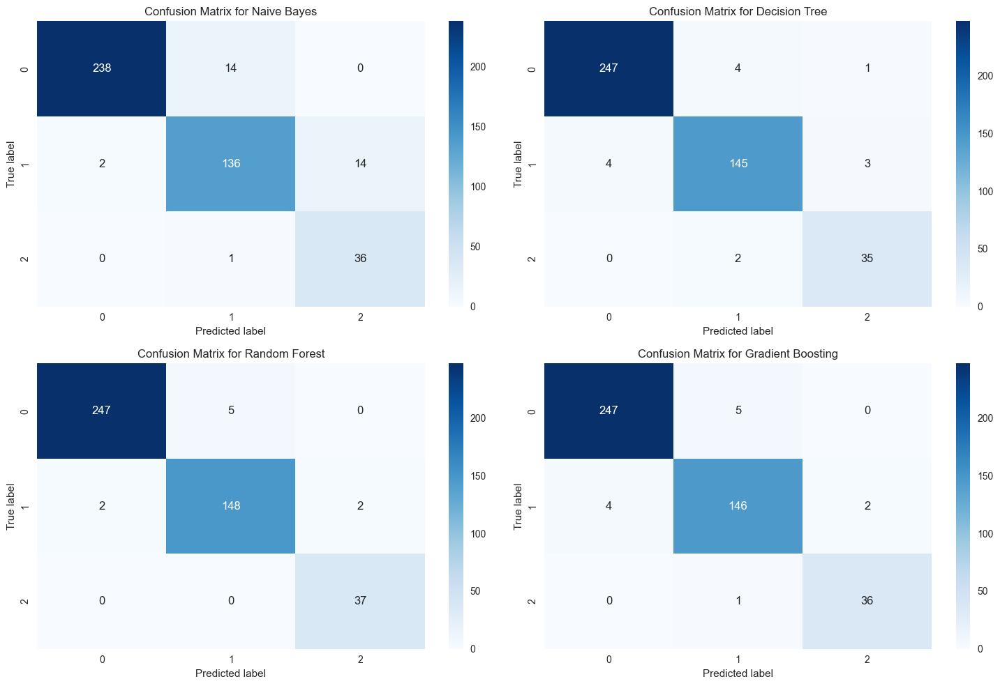

In [12]:
from sklearn.metrics import confusion_matrix

# Instantiate the classifiers
classifiers = {
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss')
}

fig, axs = plt.subplots(2, 2, figsize=(15, 10))  # Create a 2 by 2 subplot

for (classifier_name, classifier), ax in zip(classifiers.items(), axs.ravel()):
    # Fit the classifier
    classifier.fit(X_train, y_train)
    
    # Predict the test set results
    y_pred = classifier.predict(X_test)
    
    # Create a confusion matrix
    cf_matrix = confusion_matrix(y_test, y_pred)
    
    # Plot the confusion matrix
    sns.heatmap(cf_matrix, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f'Confusion Matrix for {classifier_name}')
    ax.set_ylabel('True label')
    ax.set_xlabel('Predicted label')

plt.tight_layout()
plt.show()


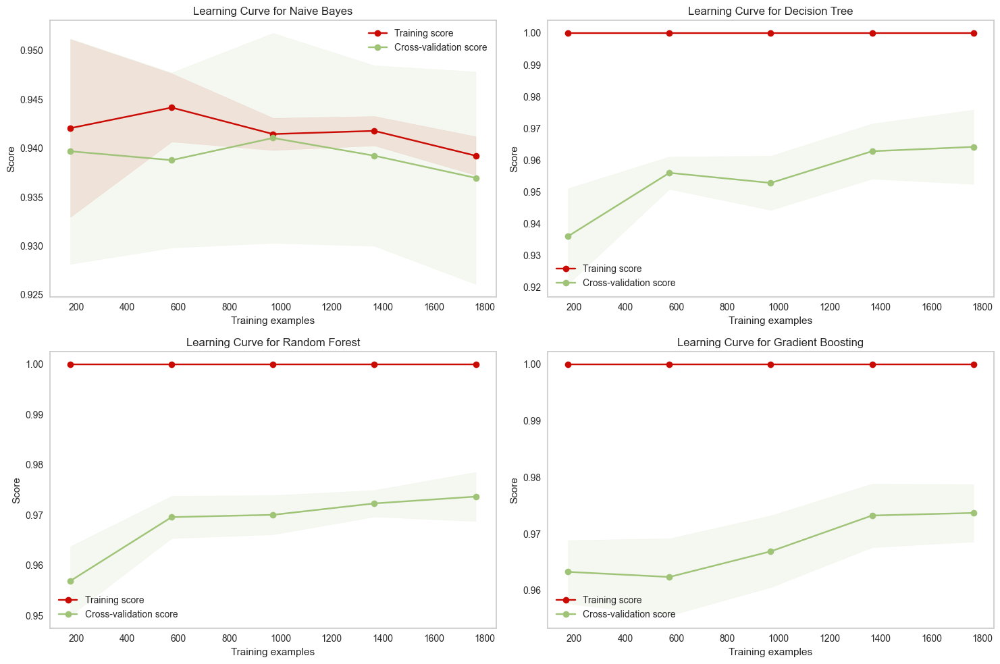

In [13]:
from sklearn.model_selection import learning_curve

def plot_learning_curve(estimator, title, X, y, axes, cv=None, n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    
    axes.set_title(title)
    axes.set_xlabel("Training examples")
    axes.set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    axes.grid()
    axes.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    axes.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1,
                     color="g")
    axes.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    axes.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")
    axes.legend(loc="best")

fig, axs = plt.subplots(2, 2, figsize=(15, 10)) # Create a 2 by 2 subplot

# Make sure your 'selected_classifiers' is a list or ordered dict, not a normal dict.
# Normal dict doesn't preserve order before Python 3.7
selected_classifiers = [
    ("Naive Bayes", GaussianNB()),
    ("Decision Tree", DecisionTreeClassifier()),
    ("Random Forest", RandomForestClassifier()),
    ("Gradient Boosting", XGBClassifier(eval_metric='mlogloss')),
]

for (name, clf), ax in zip(selected_classifiers, axs.ravel()):
    plot_learning_curve(clf, f'Learning Curve for {name}', X, y, ax, cv=5)

plt.tight_layout()
plt.show()

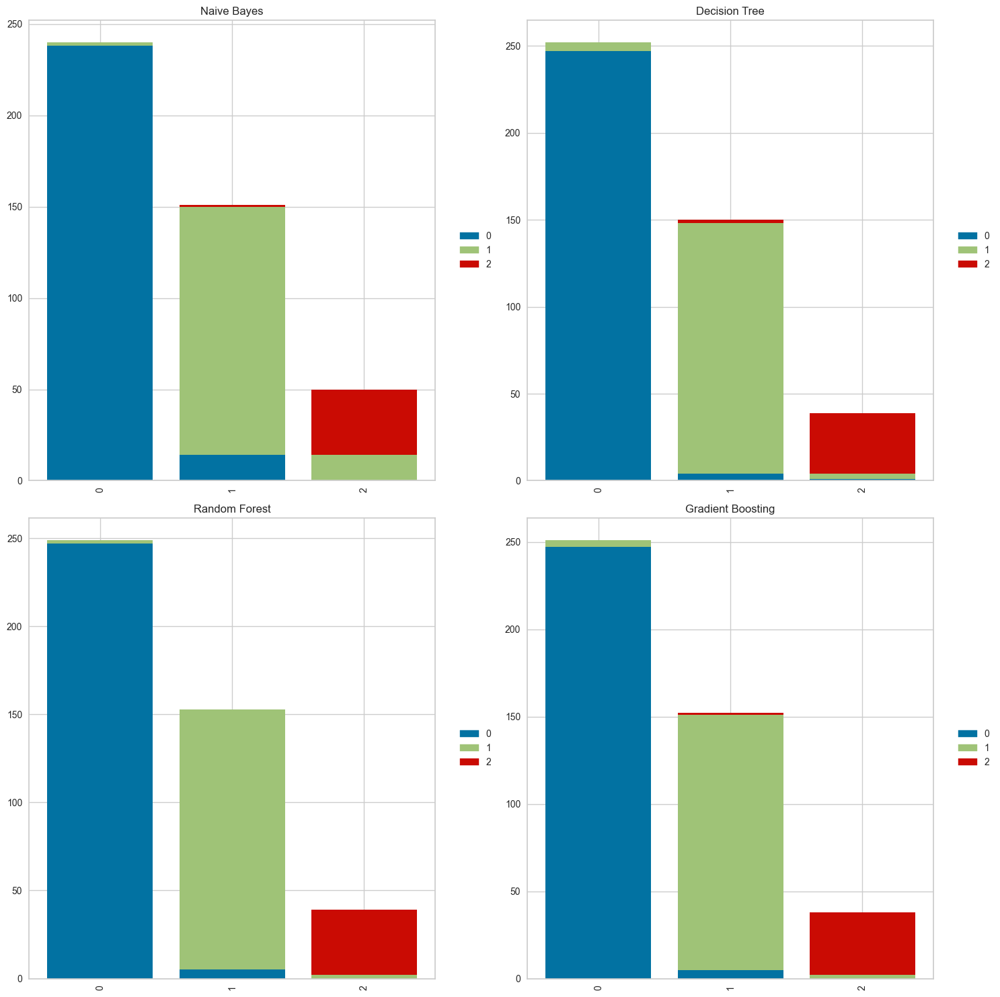

In [14]:
from yellowbrick.classifier import ClassPredictionError

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15))

# Define the dictionary of classifiers
selected_classifiers = {
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss')
}

for (classifier_name, classifier), ax in zip(selected_classifiers.items(), axes.flatten()):
    
    # Instantiate the classification model and visualizer
    visualizer = ClassPredictionError(classifier, classes=[0,1,2], ax=ax)
    
    # Fit the training data to the visualizer
    visualizer.fit(X_train, y_train)

    # Evaluate the model on the test data
    visualizer.score(X_test, y_test)

    # Set the title for the subplot
    ax.set_title(classifier_name)
    
# Display the figure
plt.tight_layout()
plt.show()


## Experiment 2 (Without SMOTE)

In [15]:
# train test split the data 


X = model_df.drop(columns=['Cluster'], axis=1)
y = model_df['Cluster']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=9)

In [16]:
y_train.value_counts()

0    975
1    653
2    136
Name: Cluster, dtype: int64

In [17]:
# Defining the models
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Support Vector Machines (SVM)": SVC(),
    "K-Nearest Neighbors (KNN)": KNeighborsClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss'),
    "Neural Networks (MLP)": MLPClassifier(),
    "AdaBoost": AdaBoostClassifier()
}

# Dataframe to store results
experiment_2 = pd.DataFrame(columns=["Model", "Training Accuracy", "Testing Accuracy", "CV Score", "Precision", "Recall", "F1 Score"])

# Loop over classifiers
for classifier_name, classifier in classifiers.items():
    # Train the classifier
    classifier.fit(X_train, y_train)

    # Make predictions on training set
    y_train_pred = classifier.predict(X_train)

    # Make predictions on testing set
    y_test_pred = classifier.predict(X_test)

    # Calculate metrics
    training_accuracy = accuracy_score(y_train, y_train_pred)
    testing_accuracy = accuracy_score(y_test, y_test_pred)
    cv_score = cross_val_score(classifier, X, y, cv=5).mean()
    precision = precision_score(y_test, y_test_pred, average='weighted')
    recall = recall_score(y_test, y_test_pred, average='weighted')
    f1 = f1_score(y_test, y_test_pred, average='weighted')

    # Append results to dataframe
    experiment_2 = experiment_2.append({
        "Model": classifier_name,
        "Training Accuracy": training_accuracy,
        "Testing Accuracy": testing_accuracy,
        "CV Score": cv_score,
        "Precision": precision,
        "Recall": recall,
        "F1 Score": f1
    }, ignore_index=True)

# Display results
experiment_2.head(10)

,Model,Training Accuracy,Testing Accuracy,CV Score,Precision,Recall,F1 Score
0,Logistic Regression,0.880952,0.868481,0.874376,0.864575,0.868481,0.856618
1,Naive Bayes,0.936508,0.947846,0.936961,0.950248,0.947846,0.948455
2,Decision Tree,1.000000,0.977324,0.965986,0.977363,0.977324,0.977294
3,Random Forest,1.000000,0.981859,0.975964,0.981980,0.981859,0.981887
4,Support Vector Machines (SVM),0.826531,0.843537,0.829025,0.785101,0.843537,0.810306
5,K-Nearest Neighbors (KNN),0.907029,0.879819,0.868934,0.875134,0.879819,0.874393
6,Gradient Boosting,1.000000,0.977324,0.973696,0.977465,0.977324,0.977363
7,Neural Networks (MLP),0.824830,0.814059,0.695692,0.795318,0.814059,0.786857
8,AdaBoost,0.963152,0.977324,0.964626,0.977363,0.977324,0.977294


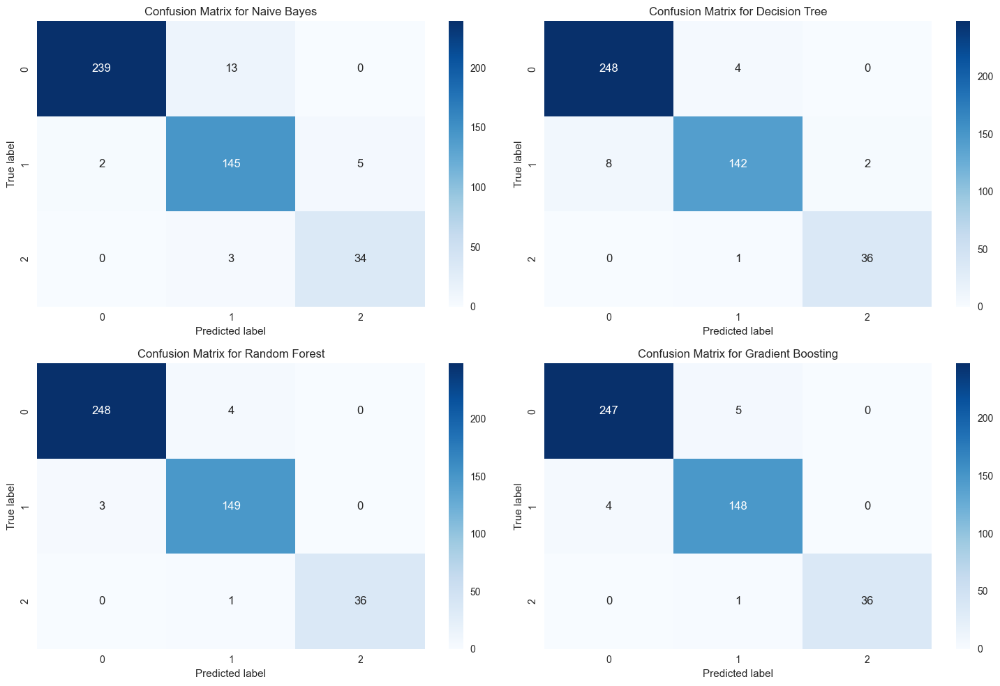

In [18]:


selected_classifiers = {
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss'),
}

fig, axs = plt.subplots(2, 2, figsize=(15, 10))  # Create a 2 by 2 subplot

for (classifier_name, classifier), ax in zip(selected_classifiers.items(), axs.ravel()):
    # Fit the classifier
    classifier.fit(X_train, y_train)
    
    # Predict the test set results
    y_pred = classifier.predict(X_test)
    
    # Create a confusion matrix
    cf_matrix = confusion_matrix(y_test, y_pred)
    
    # Plot the confusion matrix
    sns.heatmap(cf_matrix, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f'Confusion Matrix for {classifier_name}')
    ax.set_ylabel('True label')
    ax.set_xlabel('Predicted label')

plt.tight_layout()
plt.show()


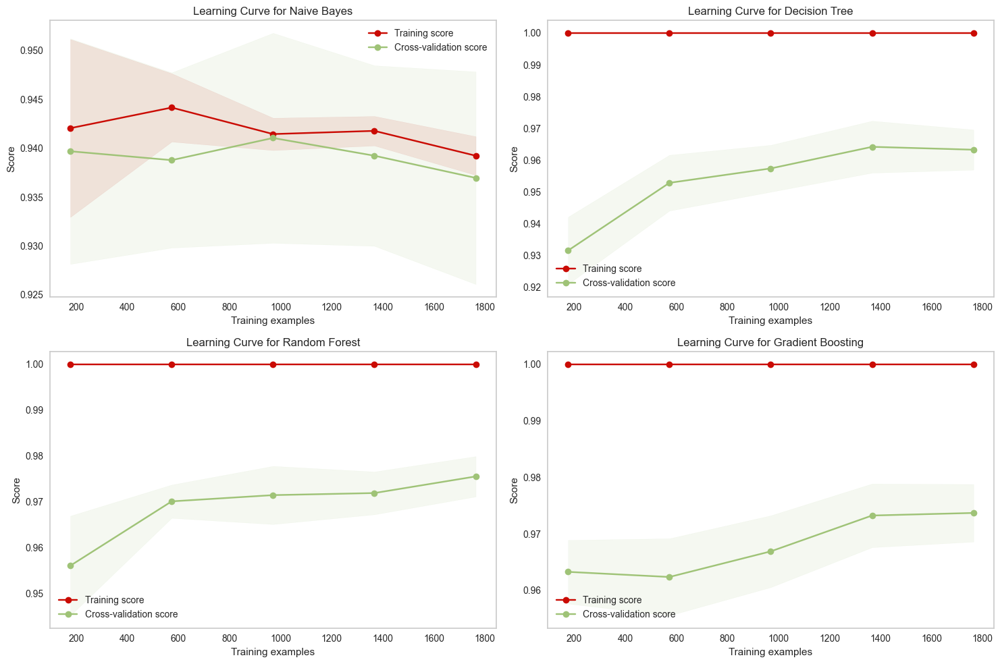

In [19]:


def plot_learning_curve(estimator, title, X, y, axes, cv=None, n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    
    axes.set_title(title)
    axes.set_xlabel("Training examples")
    axes.set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    axes.grid()
    axes.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    axes.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1,
                     color="g")
    axes.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    axes.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")
    axes.legend(loc="best")

fig, axs = plt.subplots(2, 2, figsize=(15, 10)) # Create a 2 by 2 subplot

selected_classifiers = [
    ("Naive Bayes", GaussianNB()),
    ("Decision Tree", DecisionTreeClassifier()),
    ("Random Forest", RandomForestClassifier()),
    ("Gradient Boosting", XGBClassifier(eval_metric='mlogloss')),
]

for (name, clf), ax in zip(selected_classifiers, axs.ravel()):
    plot_learning_curve(clf, f'Learning Curve for {name}', X, y, ax, cv=5)

plt.tight_layout()
plt.show()


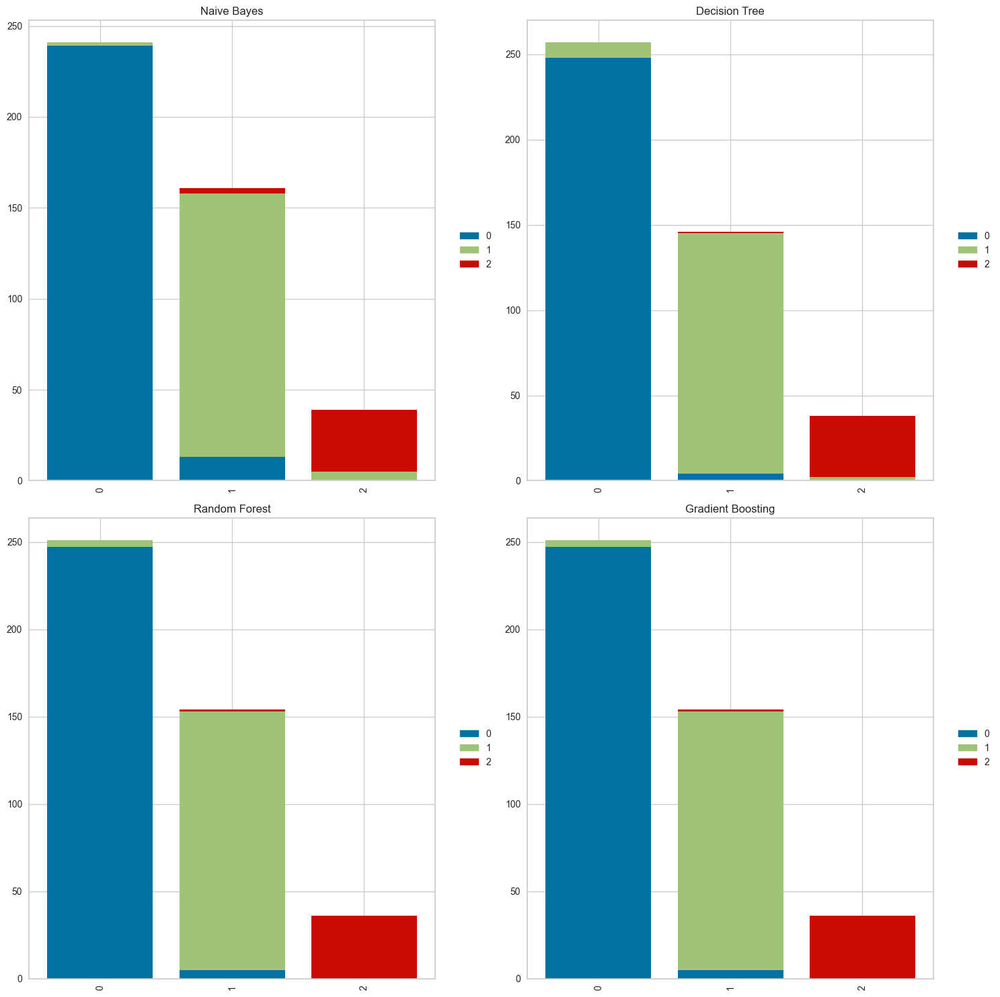

In [20]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15))

# Define the dictionary of classifiers
selected_classifiers = {
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss')
}

for (classifier_name, classifier), ax in zip(selected_classifiers.items(), axes.flatten()):
    
    # Instantiate the classification model and visualizer
    visualizer = ClassPredictionError(classifier, classes=[0,1,2], ax=ax)
    
    # Fit the training data to the visualizer
    visualizer.fit(X_train, y_train)

    # Evaluate the model on the test data
    visualizer.score(X_test, y_test)

    # Set the title for the subplot
    ax.set_title(classifier_name)
    
# Display the figure
plt.tight_layout()
plt.show()


# Experiment 3 (More Features in Dataframe)

In [21]:
model_df2.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Age,Total_spend,Total_purchase,Total_children,accepted_camp,Total_adults,Family_size,Customer_Since_Years,Education_encode,Cluster
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,66,1617,25,0,1,1,1,11,2,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,69,27,6,2,0,1,3,9,2,0
2,4141,1965,Graduation,Couple,71613.0,0,0,2013-08-21,26,426,...,58,776,21,0,0,2,2,10,2,1
3,6182,1984,Graduation,Couple,26646.0,1,0,2014-02-10,26,11,...,39,53,8,1,0,2,3,9,2,0
4,5324,1981,PhD,Couple,58293.0,1,0,2014-01-19,94,173,...,42,422,19,1,0,2,3,9,4,0


In [22]:
# drop unimportant features 

model_df2.drop(columns=['ID', 'Year_Birth', 'Education','Marital_Status','Dt_Customer'],axis=1, inplace=True)

In [23]:
# train test split the data 
from sklearn.model_selection import train_test_split

X = model_df2.drop(columns=['Cluster'], axis=1)
y = model_df2['Cluster']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=9)
y_train.value_counts()

0    975
1    653
2    136
Name: Cluster, dtype: int64

In [24]:
 # Create an instance of SMOTE
sm = SMOTE(random_state=42)

# Fit SMOTE to the training data
X_train, y_train = sm.fit_resample(X_train, y_train)
y_train.value_counts() 

1    975
0    975
2    975
Name: Cluster, dtype: int64

In [25]:
# Defining the models
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Support Vector Machines (SVM)": SVC(),
    "K-Nearest Neighbors (KNN)": KNeighborsClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss'),
    "Neural Networks (MLP)": MLPClassifier(),
    "AdaBoost": AdaBoostClassifier()
}

# Dataframe to store results
experiment_3 = pd.DataFrame(columns=["Model", "Training Accuracy", "Testing Accuracy", "CV Score", "Precision", "Recall", "F1 Score"])

# Loop over classifiers
for classifier_name, classifier in classifiers.items():
    # Train the classifier
    classifier.fit(X_train, y_train)

    # Make predictions on training set
    y_train_pred = classifier.predict(X_train)

    # Make predictions on testing set
    y_test_pred = classifier.predict(X_test)

    # Calculate metrics
    training_accuracy = accuracy_score(y_train, y_train_pred)
    testing_accuracy = accuracy_score(y_test, y_test_pred)
    cv_score = cross_val_score(classifier, X, y, cv=10).mean()
    precision = precision_score(y_test, y_test_pred, average='weighted')
    recall = recall_score(y_test, y_test_pred, average='weighted')
    f1 = f1_score(y_test, y_test_pred, average='weighted')

    # Append results to dataframe
    experiment_3 = experiment_3.append({
        "Model": classifier_name,
        "Training Accuracy": training_accuracy,
        "Testing Accuracy": testing_accuracy,
        "CV Score": cv_score,
        "Precision": precision,
        "Recall": recall,
        "F1 Score": f1
    }, ignore_index=True)

# Display results
experiment_3.head(10)

,Model,Training Accuracy,Testing Accuracy,CV Score,Precision,Recall,F1 Score
0,Logistic Regression,0.757949,0.782313,0.873030,0.834536,0.782313,0.797400
1,Naive Bayes,0.903590,0.929705,0.931983,0.939648,0.929705,0.932684
2,Decision Tree,1.000000,0.975057,0.970068,0.975207,0.975057,0.975037
3,Random Forest,1.000000,0.990930,0.979142,0.990930,0.990930,0.990930
4,Support Vector Machines (SVM),0.747350,0.829932,0.830370,0.850708,0.829932,0.836761
5,K-Nearest Neighbors (KNN),0.934017,0.852608,0.871199,0.873874,0.852608,0.859340
6,Gradient Boosting,1.000000,0.990930,0.983221,0.990930,0.990930,0.990930
7,Neural Networks (MLP),0.816068,0.823129,0.789605,0.864929,0.823129,0.835782
8,AdaBoost,0.960684,0.981859,0.957820,0.981931,0.981859,0.981823


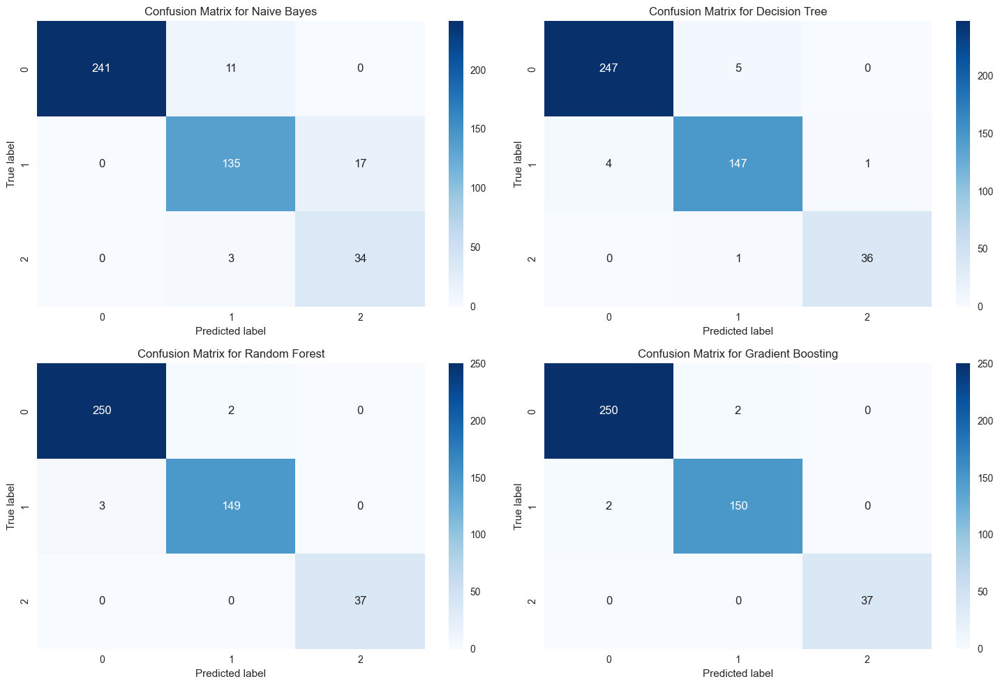

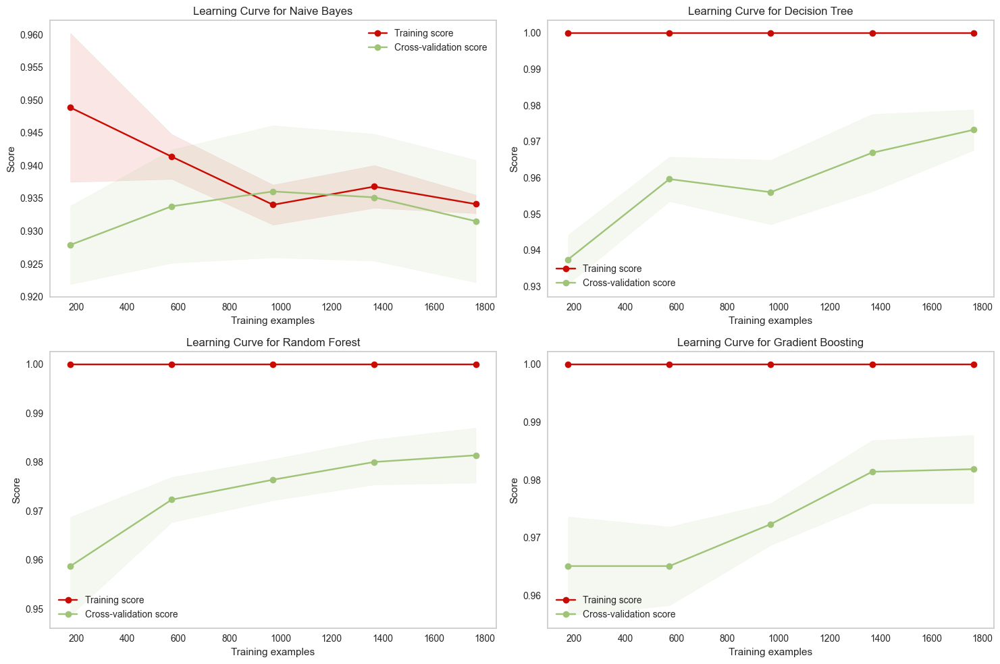

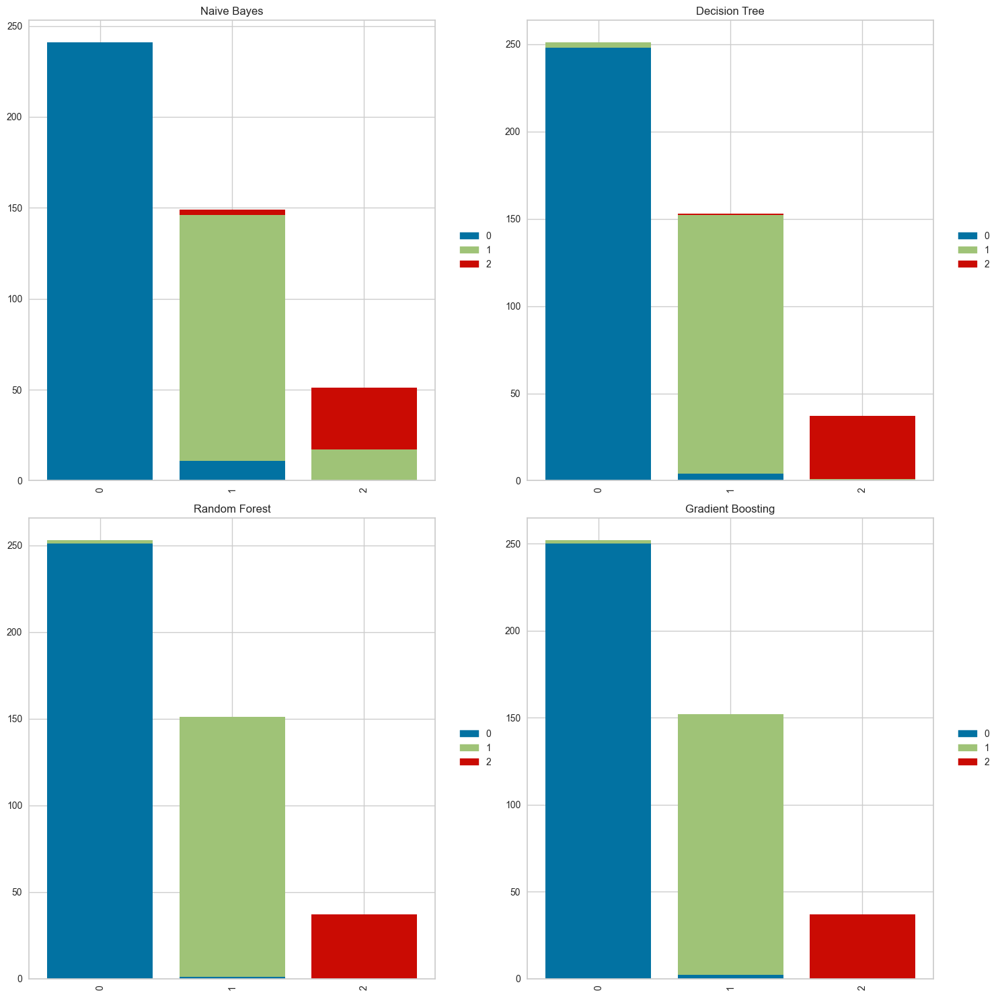

In [26]:
# Instantiate the classifiers
classifiers = {
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss')
}

fig, axs = plt.subplots(2, 2, figsize=(15, 10))  # Create a 2 by 2 subplot

for (classifier_name, classifier), ax in zip(classifiers.items(), axs.ravel()):
    # Fit the classifier
    classifier.fit(X_train, y_train)
    
    # Predict the test set results
    y_pred = classifier.predict(X_test)
    
    # Create a confusion matrix
    cf_matrix = confusion_matrix(y_test, y_pred)
    
    # Plot the confusion matrix
    sns.heatmap(cf_matrix, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f'Confusion Matrix for {classifier_name}')
    ax.set_ylabel('True label')
    ax.set_xlabel('Predicted label')

plt.tight_layout()
plt.show()


def plot_learning_curve(estimator, title, X, y, axes, cv=None, n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    
    axes.set_title(title)
    axes.set_xlabel("Training examples")
    axes.set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    axes.grid()
    axes.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    axes.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1,
                     color="g")
    axes.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    axes.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")
    axes.legend(loc="best")

fig, axs = plt.subplots(2, 2, figsize=(15, 10)) # Create a 2 by 2 subplot


selected_classifiers = [
    ("Naive Bayes", GaussianNB()),
    ("Decision Tree", DecisionTreeClassifier()),
    ("Random Forest", RandomForestClassifier()),
    ("Gradient Boosting", XGBClassifier(eval_metric='mlogloss')),
]

for (name, clf), ax in zip(selected_classifiers, axs.ravel()):
    plot_learning_curve(clf, f'Learning Curve for {name}', X, y, ax, cv=5)

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15))

# Define the dictionary of classifiers
selected_classifiers = {
    "Naive Bayes": GaussianNB(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": XGBClassifier(eval_metric='mlogloss')
}

for (classifier_name, classifier), ax in zip(selected_classifiers.items(), axes.flatten()):
    
    # Instantiate the classification model and visualizer
    visualizer = ClassPredictionError(classifier, classes=[0,1,2], ax=ax)
    
    # Fit the training data to the visualizer
    visualizer.fit(X_train, y_train)

    # Evaluate the model on the test data
    visualizer.score(X_test, y_test)

    # Set the title for the subplot
    ax.set_title(classifier_name)
    
# Display the figure
plt.tight_layout()
plt.show()


#### Based on the model development experiments 1, 2, and 3, the following conclusions can be made:

**Feature Selection**: The chosen experiment was Experiment 3, which involved the use of almost all features and the application of the Synthetic Minority Over-sampling Technique (SMOTE) to handle class imbalance. Despite differences in feature selection and handling of class imbalance among the experiments, all models performed similarly. This suggests that using a more comprehensive set of features, as in Experiment 3, provided a well-fitted input for the classification models without negatively impacting performance.

**SMOTE's Impact**: Experiment 3, which made use of SMOTE to balance the classes, was chosen over Experiment 2 which did not use SMOTE. This decision underscores the importance of handling class imbalance in the dataset. While the impact of SMOTE was not drastically apparent in the difference between the performances of the models, its utilization is critical in datasets with imbalanced classes to ensure that the minority class is not ignored.

**Model Performance**: Among all the classification algorithms tested, the Gradient Boosting method, specifically the XGBoost Classifier, showed the best performance with fewer errors in the Class Prediction Error plot. It accurately identified the main target customers (class 1), which was the objective of this exercise.

##### Given these findings, the XGBoost Classifier was chosen for further hyperparameter tuning. This process of optimization helps enhance the performance of the model by adjusting the model parameters to their ideal values. Once this is achieved, the model will be saved and deployed. The deployment of the model allows it to be used in practical applications, providing predictions on new, unseen data.
##### In conclusion, the analysis underscores the importance of careful feature selection, handling of class imbalance, and selection of the right model in creating robust and accurate predictive models. The chosen experiment and model, Experiment 3 and the XGBoost Classifier respectively, were the best fit for this dataset and problem, providing reliable predictions and highlighting the main target customer group (class 1) accurately. It also indicates the importance of model optimization via hyperparameter tuning to maximize the performance of the chosen model.

## Final Model Selected Development 
## Hyperparameter Tunning 
### GradianteBoost (XGB Classifier)

##### To ensure an accurate evaluation, the dataset model_df2 will be split into three subsets: training, validation, and testing. The training data will be used for model training, the validation data for hyperparameter optimization, and the testing data for final evaluation. This approach ensures a robust assessment of the model's performance.

#### Train-Test-Valid

In [27]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBClassifier

# Define features (X) and target (y)
X = model_df2.drop('Cluster', axis=1)  
y = model_df2['Cluster']

# Split data into training, validation, and test sets (70% - 15% - 15%)
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.18, random_state=42)  # 0.18 x 0.85 = 0.15

# Apply SMOTE to handle class imbalance in the training set
smote = SMOTE()
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

#Define the hyperparameters for RandomizedSearch
param_distributions = {
    'learning_rate': [0.01, 0.1, 0.2, 0.3], 
    'max_depth': [3, 5, 7, 10], 
    'min_child_weight': [1, 3, 5], 
    'subsample': [0.5, 0.7, 1], 
    'colsample_bytree': [0.5, 0.7, 1],
    'n_estimators' : [100, 200, 500], 
    'objective': ['binary:logistic']
}

# Initialize the XGBClassifier
xgb_classifier = XGBClassifier(eval_metric='mlogloss')

# Initialize RandomizedSearchCV and fit the training data
random_search = RandomizedSearchCV(xgb_classifier, param_distributions, cv=5, scoring='accuracy', n_jobs=-1, verbose=2, random_state=42)
random_search.fit(X_train_smote, y_train_smote)

# Get the best parameters
best_parameters = random_search.best_params_
print("Best parameters found: ", best_parameters)

# Train the model using the best parameters on the training data
best_classifier = XGBClassifier(**best_parameters, eval_metric='mlogloss')
best_classifier.fit(X_train_smote, y_train_smote)

# Predict the validation set results
y_val_pred = best_classifier.predict(X_val)

# Calculate and print the validation accuracy
val_accuracy = accuracy_score(y_val, y_val_pred)
print("Validation Accuracy: ", val_accuracy)

# Predict the test set results
y_test_pred = best_classifier.predict(X_test)

# Calculate and print the test accuracy
test_accuracy = accuracy_score(y_test, y_test_pred)
print("Test Accuracy: ", test_accuracy)


Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters found:  {'subsample': 0.7, 'objective': 'binary:logistic', 'n_estimators': 100, 'min_child_weight': 5, 'max_depth': 5, 'learning_rate': 0.2, 'colsample_bytree': 1}
Validation Accuracy:  0.9822485207100592
Test Accuracy:  0.9667673716012085


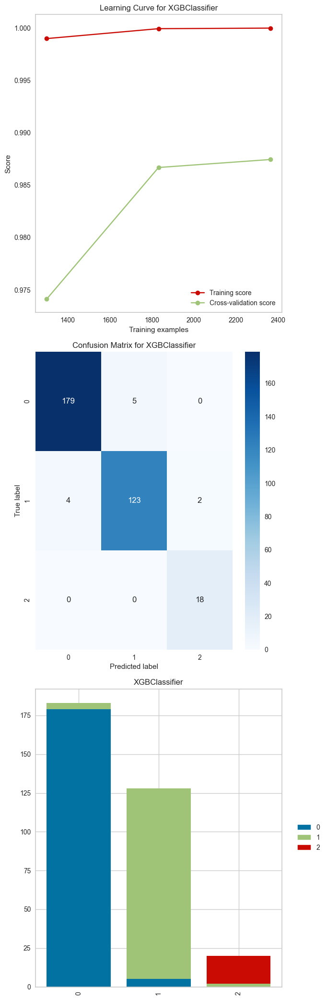

In [28]:
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import learning_curve
from yellowbrick.classifier import ClassPredictionError

# Function for plotting learning curve
def plot_learning_curve(estimator, title, X, y, ax=None):
    train_sizes, train_scores, test_scores = learning_curve(estimator, X, y, cv=10)
    
    train_scores_mean = np.mean(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    
    ax.grid()
    ax.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
    ax.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-validation score")
    ax.set_title(title)
    ax.set_xlabel("Training examples")
    ax.set_ylabel("Score")
    ax.legend(loc="best")

# Function for plotting confusion matrix
def plot_confusion_matrix(y_true, y_pred, title, ax=None):
    cf_matrix = confusion_matrix(y_true, y_pred)
    sns.heatmap(cf_matrix, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f'Confusion Matrix for {title}')
    ax.set_ylabel('True label')
    ax.set_xlabel('Predicted label')

# Function for plotting class prediction error
def plot_class_prediction_error(estimator, X, y, classes, title, ax=None):
    visualizer = ClassPredictionError(estimator, classes=classes, ax=ax)
    visualizer.fit(X, y)
    visualizer.score(X, y)
    ax.set_title(title)

# Plotting
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(7, 21))

# Plot the learning curve
plot_learning_curve(best_classifier, 'Learning Curve for XGBClassifier', X_train_smote, y_train_smote, axes[0])

# Plot the confusion matrix
plot_confusion_matrix(y_test, y_test_pred, 'XGBClassifier', axes[1])

# Plot the class prediction error
plot_class_prediction_error(best_classifier, X_test, y_test, [0, 1, 2], 'XGBClassifier', axes[2])

plt.tight_layout()
plt.show()


## Conclusion
The purpose of the presented analysis was to develop an effective predictive model that can identify the target customers. Three separate experiments were conducted with varying features and data manipulation techniques, which included SMOTE for handling class imbalance.

The experiments compared a set of classification models including logistic regression, Naive Bayes, decision tree, random forest, SVM, K-Nearest Neighbors (KNN), gradient boosting (XGB Classifier), neural networks (MLP), and AdaBoost. Among these, the gradient boosting model, specifically XGBoost, consistently performed the best across all experiments.

Experiment 3, which incorporated nearly all features and applied SMOTE for oversampling, was the most successful in terms of performance metrics, implying that both a more comprehensive feature set and balanced data contribute positively to the model's performance.

Moreover, XGBoost's performance was verified by splitting the data into training, validation, and test sets. Hyperparameter optimization was also performed to ensure that the best parameters were selected for the final model. This was initially done with GridSearchCV, but due to computational constraints, RandomizedSearchCV was utilized as a more efficient alternative.

The accuracy scores from both validation and test data demonstrate that the XGBoost model generalized well, reducing the likelihood of overfitting. Confusion matrix, learning curve, and class prediction error plots further confirmed the model's good performance.

To conclude, the XGBoost model developed in this analysis has shown to be a strong predictor for the target customers. It has a good balance between bias and variance, which makes it a reliable tool for new, unseen data. Therefore, this model was chosen as the final model, and will be saved and deployed for further use.

### Save the Model

In [29]:
import pickle


filename = 'final_model.sav'
pickle.dump(best_classifier, open(filename, 'wb'))

In [30]:
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))


### Load Model and evaluate the Model

In [31]:
# Load the model
loaded_model = pickle.load(open(filename, 'rb'))

# New data
data = {
    'Income': [24882.0, 22979.0, 27071.0, 36957.0, 70044.0],
    'Kidhome': [1, 1, 1, 1, 0],
    'Teenhome': [0, 0, 0, 1, 1],
    'Recency': [52, 29, 90, 43, 46],
    'MntWines': [1, 16, 8, 100, 1073],
    'MntFruits': [4, 17, 3, 2, 0],
    'MntMeatProducts': [10, 19, 19, 16, 250],
    'MntFishProducts': [29, 20, 0, 2, 153],
    'MntSweetProducts': [0, 21, 2, 1, 14],
    'MntGoldProds': [36, 22, 3, 31, 14],
    'NumDealsPurchases': [1, 3, 2, 4, 4],
    'NumWebPurchases': [1, 3, 2, 3, 7],
    'NumCatalogPurchases': [1, 2, 0, 2, 10],
    'NumStorePurchases': [2, 2, 3, 2, 5],
    'NumWebVisitsMonth': [6, 8, 6, 9, 5],
    'AcceptedCmp3': [1, 0, 0, 0, 0],
    'AcceptedCmp4': [0, 0, 0, 0, 0],
    'AcceptedCmp5': [0, 0, 0, 0, 0],
    'AcceptedCmp1': [0, 0, 0, 0, 0],
    'AcceptedCmp2': [0, 0, 0, 0, 0],
    'Complain': [0, 0, 0, 0, 0],
    'Response': [0, 1, 0, 1, 0],
    'Age': [45, 53, 55, 70, 69],
    'Total_spend': [80, 115, 35, 152, 1504],
    'Total_purchase': [5, 10, 7, 11, 26],
    'Total_children': [1, 1, 1, 2, 1],
    'accepted_camp': [1, 1, 0, 1, 0],
    'Total_adults': [2, 2, 1, 1, 1],
    'Family_size': [3, 3, 2, 3, 2],
    'Customer_Since_Years': [11, 11, 9, 11, 10],
    'Education_encode': [1, 2, 3, 4, 2]
}

# Convert to DataFrame
new_data = pd.DataFrame(data)

# Make predictions using the loaded model
predictions = loaded_model.predict(new_data)

# Print the predictions
print(predictions)


[0 0 0 0 1]


In [32]:
X_train.head(5)

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,Response,Age,Total_spend,Total_purchase,Total_children,accepted_camp,Total_adults,Family_size,Customer_Since_Years,Education_encode
190,24882.0,1,0,52,1,4,10,29,0,36,...,0,45,80,5,1,1,2,3,11,1
2002,22979.0,1,0,29,16,17,19,20,21,22,...,1,53,115,10,1,1,2,3,11,2
1842,27071.0,1,0,90,8,3,19,0,2,3,...,0,55,35,7,1,0,1,2,9,3
1409,36957.0,1,1,43,100,2,16,2,1,31,...,1,70,152,11,2,1,1,3,11,4
1735,70044.0,0,1,46,1073,0,250,153,14,14,...,0,69,1504,26,1,0,1,2,10,2


In [33]:
y_train.head(5)

190     0
2002    0
1842    0
1409    0
1735    1
Name: Cluster, dtype: int64

#### Predicted values and and y_train values matches